In [30]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import pandas_profiling
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
import collections
warnings.filterwarnings("ignore")
from wordcloud import WordCloud,STOPWORDS 
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import iplot
from collections import Counter,OrderedDict
from plotly.offline import iplot, init_notebook_mode
init_notebook_mode(connected = True)
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from plotly.subplots import make_subplots
from sklearn.preprocessing import StandardScaler
from matplotlib.offsetbox import (TextArea, DrawingArea, OffsetImage,
                                  AnnotationBbox)
from plotly.colors import n_colors
from plotly.subplots import make_subplots
from IPython.display import Image
from colorama import Fore, Back, Style
y_ = Fore.YELLOW
r_ = Fore.RED
g_ = Fore.GREEN
b_ = Fore.BLUE
m_ = Fore.MAGENTA
sr_ = Style.RESET_ALL


In [4]:
#Loading the dataset
movies_datas=pd.read_csv("F:\\MoviesOnStreamingPlatforms.csv")
movies_datas.shape

(16744, 17)

In [5]:
#Loading the dataset
movies_data=pd.read_csv("F:\\MoviesOnStreamingPlatforms.csv")
movies_data.shape

(16744, 17)

In [6]:
#Understanding the data
movies_datas.head(25)

,Unnamed: 0,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Netflix,Hulu,Prime Video,Disney+,Type,Directors,Genres,Country,Language,Runtime
0,0,1,Inception,2010,13+,8.8,87%,1,0,0,0,0,Christopher Nolan,"Action,Adventure,Sci-Fi,Thriller","United States,United Kingdom","English,Japanese,French",148.0
1,1,2,The Matrix,1999,18+,8.7,87%,1,0,0,0,0,"Lana Wachowski,Lilly Wachowski","Action,Sci-Fi",United States,English,136.0
2,2,3,Avengers: Infinity War,2018,13+,8.5,84%,1,0,0,0,0,"Anthony Russo,Joe Russo","Action,Adventure,Sci-Fi",United States,English,149.0
3,3,4,Back to the Future,1985,7+,8.5,96%,1,0,0,0,0,Robert Zemeckis,"Adventure,Comedy,Sci-Fi",United States,English,116.0
4,4,5,"The Good, the Bad and the Ugly",1966,18+,8.8,97%,1,0,1,0,0,Sergio Leone,Western,"Italy,Spain,West Germany",Italian,161.0
5,5,6,Spider-Man: Into the Spider-Verse,2018,7+,8.4,97%,1,0,0,0,0,"Bob Persichetti,Peter Ramsey,Rodney Rothman","Animation,Action,Adventure,Family,Sci-Fi",United States,"English,Spanish",117.0
6,6,7,The Pianist,2002,18+,8.5,95%,1,0,1,0,0,Roman Polanski,"Biography,Drama,Music,War","United Kingdom,France,Poland,Germany","English,German,Russian",150.0
7,7,8,Django Unchained,2012,18+,8.4,87%,1,0,0,0,0,Quentin Tarantino,"Drama,Western",United States,"English,German,French,Italian",165.0
8,8,9,Raiders of the Lost Ark,1981,7+,8.4,95%,1,0,0,0,0,Steven Spielberg,"Action,Adventure",United States,"English,German,Hebrew,Spanish,Arabic,Nepali",115.0
9,9,10,Inglourious Basterds,2009,18+,8.3,89%,1,0,0,0,0,Quentin Tarantino,"Adventure,Drama,War","Germany,United States","English,German,French,Italian",153.0


In [7]:
movies_datas.columns

Index(['Unnamed: 0', 'ID', 'Title', 'Year', 'Age', 'IMDb', 'Rotten Tomatoes',
       'Netflix', 'Hulu', 'Prime Video', 'Disney+', 'Type', 'Directors',
       'Genres', 'Country', 'Language', 'Runtime'],
      dtype='object')

In [8]:
movies_datas.describe()

,Unnamed: 0,ID,Year,IMDb,Netflix,Hulu,Prime Video,Disney+,Type,Runtime
count,16744.000000,16744.000000,16744.000000,16173.000000,16744.000000,16744.000000,16744.000000,16744.000000,16744.0,16152.000000
mean,8371.500000,8372.500000,2003.014035,5.902751,0.212613,0.053930,0.737817,0.033684,0.0,93.413447
std,4833.720789,4833.720789,20.674321,1.347867,0.409169,0.225886,0.439835,0.180419,0.0,28.219222
min,0.000000,1.000000,1902.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.000000
25%,4185.750000,4186.750000,2000.000000,5.100000,0.000000,0.000000,0.000000,0.000000,0.0,82.000000
50%,8371.500000,8372.500000,2012.000000,6.100000,0.000000,0.000000,1.000000,0.000000,0.0,92.000000
75%,12557.250000,12558.250000,2016.000000,6.900000,0.000000,0.000000,1.000000,0.000000,0.0,104.000000
max,16743.000000,16744.000000,2020.000000,9.300000,1.000000,1.000000,1.000000,1.000000,0.0,1256.000000


In [22]:
movies_datas.drop(['Unnamed: 0'], axis = 1,inplace=True) 

In [23]:
movies_datas.isnull().sum()

ID                     0
Title                  0
Year                   0
Age                 9390
IMDb                 571
Rotten Tomatoes    11586
Netflix                0
Hulu                   0
Prime Video            0
Disney+                0
Type                   0
Directors            726
Genres               275
Country              435
Language             599
Runtime              592
dtype: int64

In [24]:
movies_datas.fillna(method='ffill',inplace=True)
movies_datas

,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Netflix,Hulu,Prime Video,Disney+,Type,Directors,Genres,Country,Language,Runtime
0,1,Inception,2010,13+,8.8,87%,1,0,0,0,0,Christopher Nolan,"Action,Adventure,Sci-Fi,Thriller","United States,United Kingdom","English,Japanese,French",148.0
1,2,The Matrix,1999,18+,8.7,87%,1,0,0,0,0,"Lana Wachowski,Lilly Wachowski","Action,Sci-Fi",United States,English,136.0
2,3,Avengers: Infinity War,2018,13+,8.5,84%,1,0,0,0,0,"Anthony Russo,Joe Russo","Action,Adventure,Sci-Fi",United States,English,149.0
3,4,Back to the Future,1985,7+,8.5,96%,1,0,0,0,0,Robert Zemeckis,"Adventure,Comedy,Sci-Fi",United States,English,116.0
4,5,"The Good, the Bad and the Ugly",1966,18+,8.8,97%,1,0,1,0,0,Sergio Leone,Western,"Italy,Spain,West Germany",Italian,161.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16739,16740,The Ghosts of Buxley Hall,1980,all,6.2,55%,0,0,0,1,0,Bruce Bilson,"Comedy,Family,Fantasy,Horror",United States,English,120.0
16740,16741,The Poof Point,2001,7+,4.7,55%,0,0,0,1,0,Neal Israel,"Comedy,Family,Sci-Fi",United States,English,90.0
16741,16742,Sharks of Lost Island,2013,7+,5.7,55%,0,0,0,1,0,Neil Gelinas,Documentary,United States,English,90.0
16742,16743,Man Among Cheetahs,2017,7+,6.6,55%,0,0,0,1,0,Richard Slater-Jones,Documentary,United States,English,90.0


In [26]:
movies_datas.fillna(movies_datas.mean(axis=0),inplace=True)
movies_datas

,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Netflix,Hulu,Prime Video,Disney+,Type,Directors,Genres,Country,Language,Runtime
0,1,Inception,2010,13+,8.8,87%,1,0,0,0,0,Christopher Nolan,"Action,Adventure,Sci-Fi,Thriller","United States,United Kingdom","English,Japanese,French",148.0
1,2,The Matrix,1999,18+,8.7,87%,1,0,0,0,0,"Lana Wachowski,Lilly Wachowski","Action,Sci-Fi",United States,English,136.0
2,3,Avengers: Infinity War,2018,13+,8.5,84%,1,0,0,0,0,"Anthony Russo,Joe Russo","Action,Adventure,Sci-Fi",United States,English,149.0
3,4,Back to the Future,1985,7+,8.5,96%,1,0,0,0,0,Robert Zemeckis,"Adventure,Comedy,Sci-Fi",United States,English,116.0
4,5,"The Good, the Bad and the Ugly",1966,18+,8.8,97%,1,0,1,0,0,Sergio Leone,Western,"Italy,Spain,West Germany",Italian,161.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16739,16740,The Ghosts of Buxley Hall,1980,all,6.2,55%,0,0,0,1,0,Bruce Bilson,"Comedy,Family,Fantasy,Horror",United States,English,120.0
16740,16741,The Poof Point,2001,7+,4.7,55%,0,0,0,1,0,Neal Israel,"Comedy,Family,Sci-Fi",United States,English,90.0
16741,16742,Sharks of Lost Island,2013,7+,5.7,55%,0,0,0,1,0,Neil Gelinas,Documentary,United States,English,90.0
16742,16743,Man Among Cheetahs,2017,7+,6.6,55%,0,0,0,1,0,Richard Slater-Jones,Documentary,United States,English,90.0


In [62]:
movies_datas.isnull().sum()

ID                 0
Title              0
Year               0
Age                0
IMDb               0
Rotten Tomatoes    0
Netflix            0
Hulu               0
Prime Video        0
Disney+            0
Type               0
Directors          0
Genres             0
Country            0
Language           0
Runtime            0
dtype: int64

In [63]:
pandas_profiling.ProfileReport(movies_datas)

In [92]:
#Total number of unique directors
len(movies_data['Directors'].unique())

11338

In [93]:
len(movies_data['Genres'].unique())

1909

In [94]:
len(movies_data['Language'].unique())

1103

In [95]:
print('Minimum IMDb rating: ', movies_data['IMDb'].min())
print('Maximum IMDb rating: ', movies_data['IMDb'].max())

Minimum IMDb rating:  0.0
Maximum IMDb rating:  9.3


In [206]:
movies_data=pd.read_csv("F:\\MoviesOnStreamingPlatforms.csv")
movies_data.shape

(16744, 17)

In [96]:
indian_movies = movies_datas[movies_datas.Country =='India']
indian_movies

,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Netflix,Hulu,Prime Video,Disney+,Type,Directors,Genres,Country,Language,Runtime
11,12,3 Idiots,2009,13+,8.4,100%,1,0,1,0,0,Rajkumar Hirani,"Comedy,Drama",India,"Hindi,English",170.0
34,35,Dangal,2016,7+,8.4,88%,1,0,0,0,0,Nitesh Tiwari,"Action,Biography,Drama,Sport",India,Hindi,161.0
38,39,Like Stars on Earth,2007,7+,8.4,91%,1,0,0,0,0,"Aamir Khan,Amole Gupte","Drama,Family",India,"Hindi,English",165.0
81,82,Lagaan: Once Upon a Time in India,2001,7+,8.1,95%,1,0,0,0,0,Ashutosh Gowariker,"Adventure,Drama,Musical,Sport",India,"Hindi,English,Awadhi,Urdu",224.0
88,89,Bahubali: The Beginning,2015,13+,8.1,88%,1,0,0,0,0,S.S. Rajamouli,"Action,Drama",India,"Telugu,Tamil",159.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15820,15821,Escape From Taliban,2003,NaN,4.5,NaN,0,0,1,0,0,Ujjwal Chatterjee,"Adventure,Drama,Thriller,War",India,"Hindi,English,Urdu",166.0
15822,15823,Machine,2007,18+,2.7,NaN,0,0,1,0,0,"Abbas Alibhai Burmawalla,Mastan Alibhai Burmaw...","Action,Mystery,Romance,Thriller",India,Hindi,148.0
15854,15855,KAALA (Malayalam),2018,NaN,NaN,NaN,0,0,1,0,0,Anuraj,"Short,Mystery",India,Malayalam,20.0
16064,16065,Prathighatana,2014,NaN,NaN,NaN,0,0,1,0,0,Tammareddy Bharadwaja,Drama,India,Telugu,117.0


In [29]:
print('Total number of Indian movies                : ',indian_movies['Title'].count() )


Total number of Indian movies                :  1160


In [1]:
indian_movies = indian_movies[indian_movies['IMDb'] > 7]


NameError: name 'indian_movies' is not defined

In [33]:
telugu_movies = movies_data[movies_data.Language =='Telugu']
telugu_movies

,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Directors,Genres,Country,Language,Streaming Platform
39110,5623,Rangasthalam,2018,13+,8.4,NaN,Sukumar,"Action,Drama",India,Telugu,Prime Video
39337,5850,Athadu,2005,NaN,8.2,NaN,Trivikram Srinivas,"Action,Thriller",India,Telugu,Prime Video
41472,7985,Kshana Kshanam,1991,NaN,8.1,NaN,Ram Gopal Varma,"Comedy,Crime,Drama,Thriller",India,Telugu,Prime Video
40562,7075,Anukokunda Oka Roju,2005,NaN,8.0,NaN,Chandra Sekhar Yeleti,"Mystery,Thriller",India,Telugu,Prime Video
1732,1733,Ee Nagaraniki Emaindi,2018,7+,7.9,NaN,Tharun Bhascker Dhaassyam,"Comedy,Drama",India,Telugu,Netflix
...,...,...,...,...,...,...,...,...,...,...,...
46678,13191,Balakrishnudu,2017,NaN,4.6,NaN,Pavan Mallela,"Action,Comedy,Romance",India,Telugu,Prime Video
43992,10505,Ye Mantram Vesave,2018,all,4.1,NaN,Shridhar Marri,Drama,India,Telugu,Prime Video
48809,15322,Devaraya,2012,NaN,3.8,NaN,Nani Krishna,Comedy,India,Telugu,Prime Video
47308,13821,Kundanapu Bomma,2016,all,NaN,NaN,Vara Mullapoodi,Drama,India,Telugu,Prime Video


In [35]:
print('Total number of Telugu movies                : ',telugu_movies['Title'].count() )


Total number of Telugu movies                :  67


In [97]:
netflix_movies = movies_datas[movies_datas['Netflix'] == 1]
hulu_movies = movies_datas[movies_datas['Hulu'] == 1]
prime_movies =movies_datas[movies_datas['Prime Video'] == 1]
disney_movies = movies_datas[movies_datas['Disney+'] == 1]

In [73]:
def generate_word_cloud(text):
    wordcloud = WordCloud(
        width = 3000,
        height = 2000,
        background_color = 'black').generate(str(text))
    fig = plt.figure(
        figsize = (40, 30),
        facecolor = 'k',
        edgecolor = 'k')
    plt.imshow(wordcloud, interpolation = 'bilinear')
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.show()

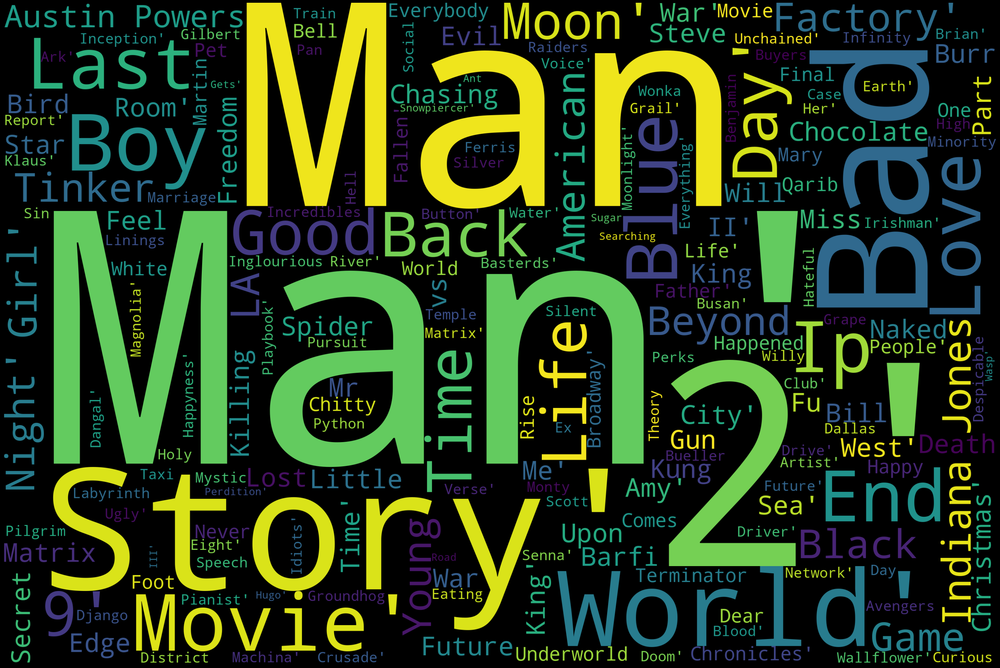

In [74]:
netflix_titles = netflix_movies.Title[:500].values
generate_word_cloud(netflix_titles)

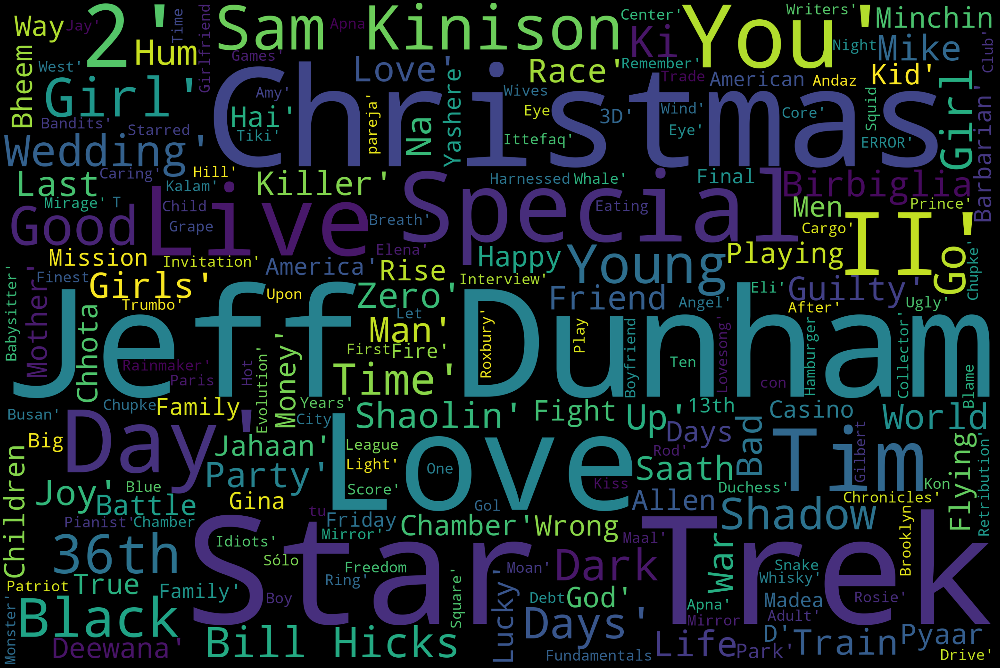

In [76]:
prime_titles = prime_movies.Title[:500].values
generate_word_cloud(prime_titles)

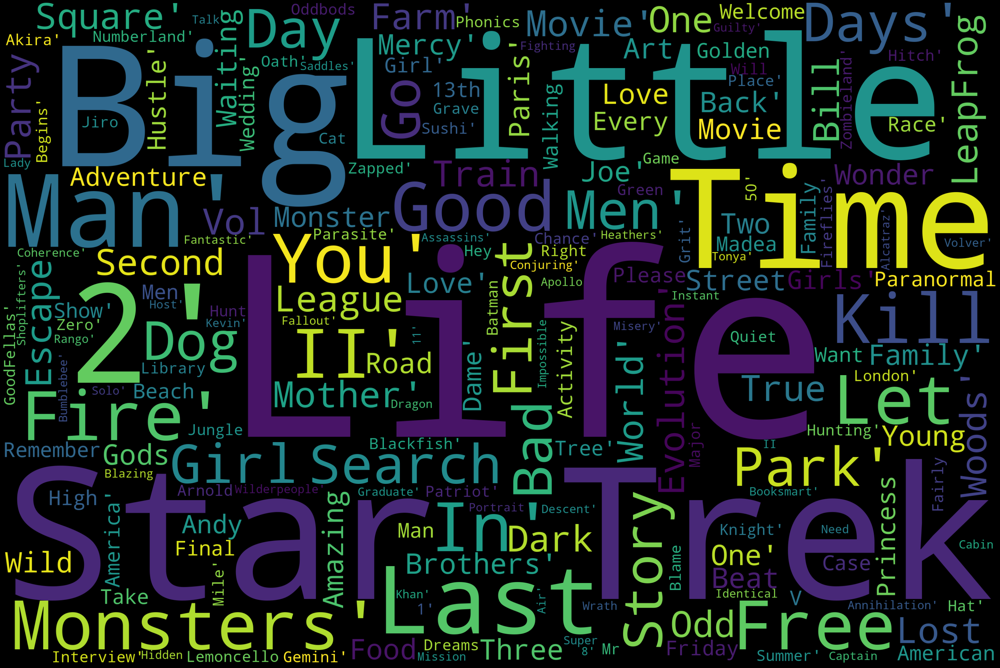

In [41]:
hulu_titles = hulu_movies.Title[:500].values
generate_word_cloud(hulu_titles)

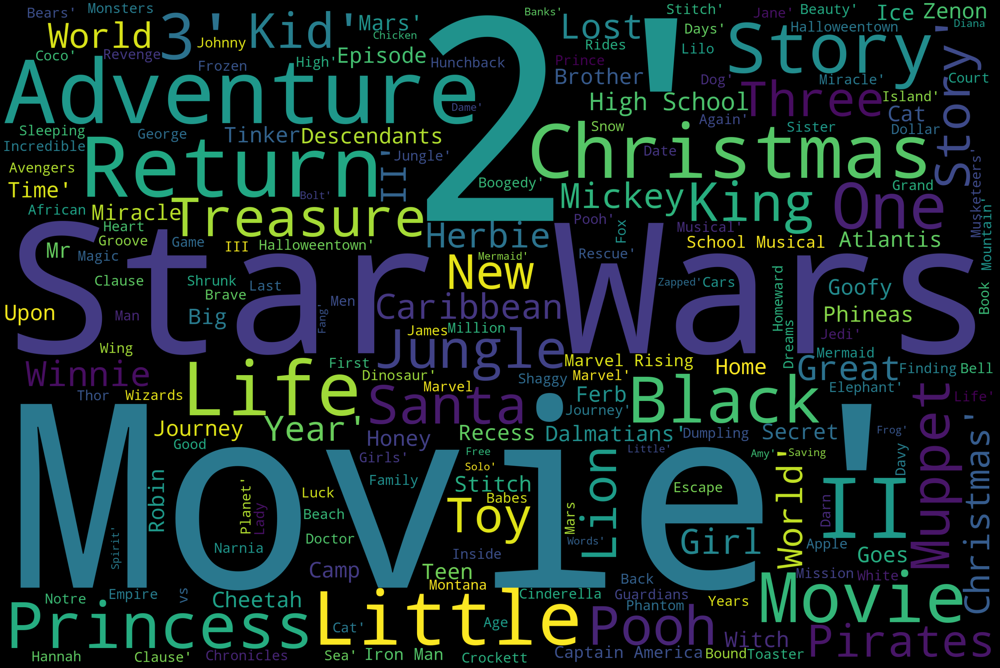

In [42]:
disney_titles = disney_movies.Title[:500].values
generate_word_cloud(disney_titles)

In [99]:
top_Runtime = movies_datas.sort_values('Runtime',ascending = False).head(20)

In [100]:
fig = px.bar(top_Runtime, x='Title', y='Runtime', color='Runtime', height=500, title='Runtime of the top 10 longest movies')
fig.show()

In [101]:
yearly_movie_count = movies_data.groupby('Year')['Title'].count().reset_index().rename(columns = {'Title':'MovieCount'})

In [102]:
yearly_movie_count = yearly_movie_count.sort_values(by='MovieCount',ascending=False)

In [103]:
yearly_movie_count.head(30)

,Year,MovieCount
105,2017,1478
106,2018,1359
104,2016,1253
103,2015,1108
102,2014,1015
101,2013,1001
100,2012,877
107,2019,727
99,2011,677
97,2009,566


In [104]:
fig = px.bar(yearly_movie_count[:30], x='Year', y='MovieCount', color='MovieCount', height=600)
fig.show()

In [107]:
netflix_movies_count = len(movies_datas[movies_datas['Netflix'] == 1].index)
hulu_movies_count = len(movies_datas[movies_datas['Hulu'] == 1].index)
prime_movies_count =len(movies_datas[movies_datas['Prime Video'] == 1].index)
disney_movies_count = len(movies_datas[movies_datas['Disney+'] == 1].index)


print(netflix_movies_count)
print(hulu_movies_count)
print(prime_movies_count)
print(disney_movies_count)

3560
903
12354
564


In [108]:
label=['Netflix','Hulu', 'Prime Video','Disney+']
count=[netflix_movies_count,hulu_movies_count,prime_movies_count,disney_movies_count]
platform = pd.DataFrame(
    {'Platform': label,
     'MovieCount': count,
    })
platform

,Platform,MovieCount
0,Netflix,3560
1,Hulu,903
2,Prime Video,12354
3,Disney+,564


In [109]:
fig = px.pie(platform,names='Platform', values='MovieCount')
fig.update_traces(rotation=45, pull=[0.1,0.03,0.03,0.03,0.03],textinfo="percent+label", title='Movie Count per platform')
fig.show()

In [110]:
movies_data['Genres'].value_counts().head(5)

Drama           1392
Documentary     1306
Comedy          1101
Comedy,Drama     472
Horror           448
Name: Genres, dtype: int64

In [111]:
top_5_genres = ['Drama','Documentary','Comedy', 'Comedy,Drama','Horror']
table = movies_data.loc[:,['Year','Genres','IMDb']]
table['AvgRating'] = table.groupby([table.Genres,table.Year])['IMDb'].transform('mean')
table.drop('IMDb', axis=1, inplace=True)
table = table[(table.Year>2009) & (table.Year<2020)]
table = table.loc[table['Genres'].isin(top_5_genres)]
table = table.sort_values('Year')

In [112]:
fig=px.bar(table,x='Genres', y='AvgRating', animation_frame='Year', 
           animation_group='Genres', color='Genres', hover_name='Genres', range_y=[0,10])
fig.update_layout(showlegend=False)
fig.show()

In [113]:
top_movies=movies_data[movies_data['IMDb']==9.3][['Title','Directors']]
top_movies

,Title,Directors
38598,Love on a Leash,Fen Tian
1292,My Next Guest with David Letterman and Shah Ru...,Fen Tian
40708,"Down, But Not Out!",Miguel Gaudêncio
40054,Square One,Danny Wu
40325,Steven Banks: Home Entertainment Center,Tom McLoughlin
40914,Bounty,Roger Donaldson


In [115]:
runtime_top_movies=movies_datas.loc[movies_datas['IMDb']==9.3][['Title','Runtime']]
runtime_top_movies

,Title,Runtime
1292,My Next Guest with David Letterman and Shah Ru...,61.0
5110,Love on a Leash,90.0
6566,Square One,83.0
6837,Steven Banks: Home Entertainment Center,60.0
7220,"Down, But Not Out!",68.0
7426,Bounty,132.0


In [116]:
movies_by_country = movies_data.groupby('Country')['Title'].count().reset_index().sort_values('Title',ascending = False).head(10).rename(columns = {'Title':'MovieCount'})
fig = px.pie(movies_by_country,names='Country', values='MovieCount')
fig.update_traces(rotation=180, pull=[0.1,0.03,0.03,0.03,0.03],textinfo="percent+label", title='Movie Count per Country')
fig.update_layout(showlegend=False)
fig.show()


In [118]:
lengthiest_movie=movies_datas.sort_values(by='Runtime',ascending=False).head(10)

In [119]:
fig=px.bar(lengthiest_movie,x='Title',y='IMDb',height=600,color='Title',range_y=[0,10])
fig.update_layout(title='IMDb Ratings Lengthiest Movie')
fig.show()

In [120]:
movies_count_by_IMDB=movies_data.groupby('IMDb')['Title'].count().reset_index().sort_values('IMDb',ascending=False).head(10).rename(columns={'Title':'Count'})
fig=px.pie(movies_count_by_IMDB,names='IMDb',values='Count')
fig.update_traces(textinfo='percent+label',title='Movies Count based on IMDb Ratings')
fig.show()

In [122]:
top5_netflix=movies_datas.loc[:,['Netflix','IMDb','Title','Year']]
top5_netflix=top5_netflix[top5_netflix['Netflix']==1]
top5_netflix=top5_netflix.sort_values('IMDb',ascending=False).head(5)
fig=px.bar(top5_netflix,x='Title',y='IMDb',height=600,color='IMDb',range_y=[0,10])
fig.update_layout(title='Top 5 Netflix Movies based on IMDb Rating')
fig.show()

In [124]:
top5_hulu=movies_datas.loc[:,['Hulu','IMDb','Title','Year']]
top5_hulu=top5_hulu[top5_hulu['Hulu']==1]
top5_hulu=top5_hulu.sort_values('IMDb',ascending=False).head(5)
fig=px.bar(top5_hulu,x='Title',y='IMDb',height=600,color='Title',range_y=[0,10])
fig.update_layout(title='Top 5 Hulu Movies based on IMDb Rating')
fig.show()

In [125]:
top5_prime=movies_datas.loc[:,['Prime Video','IMDb','Title','Year']]
top5_prime=top5_prime[top5_prime['Prime Video']==1]
top5_prime=top5_prime.sort_values('IMDb',ascending=False).head(5)
fig=px.bar(top5_prime,x='Title',y='IMDb',height=600,color='Title',range_y=[0,10])
fig.update_layout(title='Top 5 Prime Movies based on IMDb Rating')
fig.show()

In [77]:
top5_disney=movies_datas.loc[:,['Disney+','IMDb','Title','Year']]
top5_disney=top5_disney[top5_disney['Disney+']==1]
top5_disney=top5_disney.sort_values('IMDb',ascending=False).head(5)
fig=px.bar(top5_disney,x='Title',y='IMDb',height=600,color='Title',range_y=[0,10])
fig.update_layout(title='Top 5 Disney Movies based on IMDb Rating')
fig.show()

In [126]:
#top20_dir=data.groupby(['Directors','IMDb'])['Title'].count().reset_index().sort_values('IMDb',ascending=False).head(20)
top20_dir=movies_data.loc[:,['Directors','IMDb','Title','Year']].sort_values('IMDb',ascending=False)

top20_dir.head(20)

,Directors,IMDb,Title,Year
38598,Fen Tian,9.3,Love on a Leash,2011
40708,Miguel Gaudêncio,9.3,"Down, But Not Out!",2015
40054,Danny Wu,9.3,Square One,2019
40325,Tom McLoughlin,9.3,Steven Banks: Home Entertainment Center,1989
40914,Roger Donaldson,9.3,Bounty,2011
1292,Fen Tian,9.3,My Next Guest with David Letterman and Shah Ru...,2019
947,Mahesh Manjrekar,9.1,Natsamrat,2016
41946,Rel Dowdell,9.1,Where's Daddy?,2017
40979,"Chris Leslie,Oggi Tomic",9.1,Finding Family,2013
20304,Christopher Nolan,9.0,The Dark Knight,2008


In [128]:
sum_age = movies_datas.groupby("Age").sum()
sum_age[["Netflix","Hulu","Prime Video","Disney+"]]

,Netflix,Hulu,Prime Video,Disney+
Age,,,,
13+,383,119,819,40
16+,89,17,226,1
18+,752,290,2612,3
7+,323,109,916,179
all,130,55,406,277


In [129]:
# number of moive produce each year per platform:
sum_year = movies_datas.groupby("Year").sum()
sum_year[["Netflix","Hulu","Prime Video","Disney+"]]

,Netflix,Hulu,Prime Video,Disney+
Year,,,,
1902,0,0,1,0
1912,0,0,1,0
1913,0,0,2,0
1915,0,0,4,0
1916,0,0,1,0
...,...,...,...,...
2016,444,62,730,17
2017,569,124,763,22
2018,560,158,625,16


In [134]:
df_roto = movies_datas[movies_datas['Rotten Tomatoes'].notnull()]

In [135]:
# convert str to float type for "Rotten Tomatoes" column:
df_roto['Rotten Tomatoes'] = df_roto['Rotten Tomatoes'].str.rstrip('%').astype('float')

In [136]:
df_roto.head(10)

,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Netflix,Hulu,Prime Video,Disney+,Type,Directors,Genres,Country,Language,Runtime
0,1,Inception,2010,13+,8.8,87.0,1,0,0,0,0,Christopher Nolan,"Action,Adventure,Sci-Fi,Thriller","United States,United Kingdom","English,Japanese,French",148.0
1,2,The Matrix,1999,18+,8.7,87.0,1,0,0,0,0,"Lana Wachowski,Lilly Wachowski","Action,Sci-Fi",United States,English,136.0
2,3,Avengers: Infinity War,2018,13+,8.5,84.0,1,0,0,0,0,"Anthony Russo,Joe Russo","Action,Adventure,Sci-Fi",United States,English,149.0
3,4,Back to the Future,1985,7+,8.5,96.0,1,0,0,0,0,Robert Zemeckis,"Adventure,Comedy,Sci-Fi",United States,English,116.0
4,5,"The Good, the Bad and the Ugly",1966,18+,8.8,97.0,1,0,1,0,0,Sergio Leone,Western,"Italy,Spain,West Germany",Italian,161.0
5,6,Spider-Man: Into the Spider-Verse,2018,7+,8.4,97.0,1,0,0,0,0,"Bob Persichetti,Peter Ramsey,Rodney Rothman","Animation,Action,Adventure,Family,Sci-Fi",United States,"English,Spanish",117.0
6,7,The Pianist,2002,18+,8.5,95.0,1,0,1,0,0,Roman Polanski,"Biography,Drama,Music,War","United Kingdom,France,Poland,Germany","English,German,Russian",150.0
7,8,Django Unchained,2012,18+,8.4,87.0,1,0,0,0,0,Quentin Tarantino,"Drama,Western",United States,"English,German,French,Italian",165.0
8,9,Raiders of the Lost Ark,1981,7+,8.4,95.0,1,0,0,0,0,Steven Spielberg,"Action,Adventure",United States,"English,German,Hebrew,Spanish,Arabic,Nepali",115.0
9,10,Inglourious Basterds,2009,18+,8.3,89.0,1,0,0,0,0,Quentin Tarantino,"Adventure,Drama,War","Germany,United States","English,German,French,Italian",153.0


In [139]:
# average IMDb rate on Disney+:
no_disney = df_roto['Disney+'].sum()
disney_avg_imdb = round(df_roto.loc[df_roto['Disney+']==1]['IMDb'].mean(),1)
# average IMDb rate on Hulu:
no_hulu = df_roto['Hulu'].sum()
hulu_avg_imdb = round(df_roto.loc[df_roto['Hulu']==1]['IMDb'].mean(),1)
# average IMDb rate on Netflix:
no_netflix = df_roto['Netflix'].sum()
netflix_avg_imdb = round(df_roto.loc[df_roto['Netflix']==1]['IMDb'].mean(),1)
# average IMDb rate on Prime Video:
no_prime = df_roto['Prime Video'].sum()
prime_avg_imdb = round(df_roto.loc[df_roto['Prime Video']==1]['IMDb'].mean(),1)

In [140]:
# average Rotten Tomatoes rate on Disney+:
disney_avg_roto = round(df_roto.loc[df_roto['Disney+']==1]['Rotten Tomatoes'].mean(),1)
# average Rotten Tomatoes rate on Hulu:
hulu_avg_roto = round(df_roto.loc[df_roto['Hulu']==1]['Rotten Tomatoes'].mean(),1)
# average Rotten Tomatoes rate on Netflix:
netflix_avg_roto = round(df_roto.loc[df_roto['Netflix']==1]['Rotten Tomatoes'].mean(),1)
# average Rotten Tomatoes rate on Prime Video:
prime_avg_roto = round(df_roto.loc[df_roto['Prime Video']==1]['Rotten Tomatoes'].mean(),1)

In [142]:
# create dataframe:
no_platform = (no_netflix,no_hulu,no_prime,no_disney)
col_names = ('Netflix','Hulu','Prime Video','Disney+')
avg_imdb = (netflix_avg_imdb,hulu_avg_imdb,prime_avg_imdb,disney_avg_imdb)
avg_roto = (netflix_avg_roto,hulu_avg_roto,prime_avg_roto,disney_avg_roto)
List = list(zip(col_names,no_platform,avg_imdb,avg_roto))
Counts =  pd.DataFrame(data=List,columns=['Platform','Number of Movie','Average IDMb rate','Average % Rotten Tomattoes rate'])
Counts

,Platform,Number of Movie,Average IDMb rate,Average % Rotten Tomattoes rate
0,Netflix,1427,6.4,66.2
1,Hulu,637,6.4,66.9
2,Prime Video,3077,6.3,64.3
3,Disney+,345,6.5,64.3


In [143]:
px.bar(
       x=movies_data['Age'].value_counts().index,
       y=movies_data['Age'].value_counts().values,
       labels = {'x': "Age Restrictions", 'y':"Count"}
    )

In [145]:
movies_datas.query('Netflix == 1 and Hulu == 1 and `Prime Video` == 1')['Title']

148                The Square
340             The Interview
497                    Blame!
610                 Evolution
1133    No Game No Life: Zero
2017                   Mother
Name: Title, dtype: object

<AxesSubplot:xlabel='Year', ylabel='IMDb'>

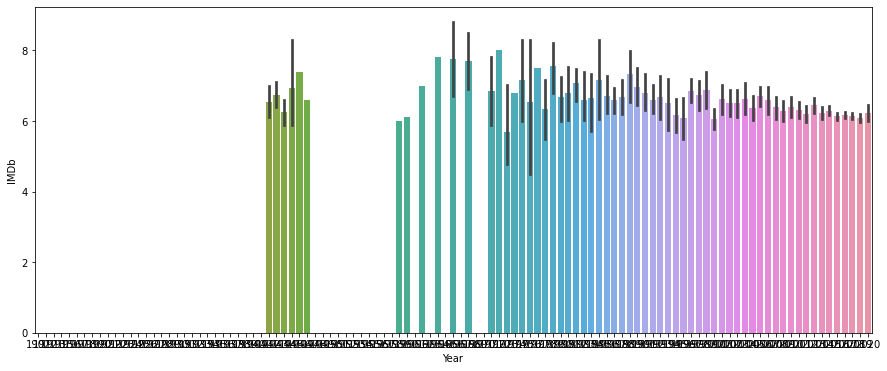

In [146]:
fig, ax = plt.subplots(figsize=(15,6))
sns.barplot(movies_datas.dropna(axis=0,subset=["IMDb"],inplace=False)["Year"],movies_data.dropna(axis=0,subset=["IMDb"],inplace=False)["IMDb"],ax=ax)

In [148]:
new_data=movies_datas.dropna(subset=["IMDb"])
new_data.corr()

,ID,Year,IMDb,Netflix,Hulu,Prime Video,Disney+,Type,Runtime
ID,1.000000,-0.279648,-0.399953,-0.710985,-0.218750,0.545740,0.303166,NaN,-0.197143
Year,-0.279648,1.000000,-0.021181,0.262778,0.102054,-0.259313,-0.043057,NaN,0.090788
IMDb,-0.399953,-0.021181,1.000000,0.135105,0.042191,-0.163447,0.075895,NaN,0.088987
Netflix,-0.710985,0.262778,0.135105,1.000000,-0.109744,-0.751582,-0.090506,NaN,0.097228
Hulu,-0.218750,0.102054,0.042191,-0.109744,1.000000,-0.256182,-0.035540,NaN,0.032773
Prime Video,0.545740,-0.259313,-0.163447,-0.751582,-0.256182,1.000000,-0.302786,NaN,-0.063838
Disney+,0.303166,-0.043057,0.075895,-0.090506,-0.035540,-0.302786,1.000000,NaN,-0.022088
Type,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Runtime,-0.197143,0.090788,0.088987,0.097228,0.032773,-0.063838,-0.022088,NaN,1.000000


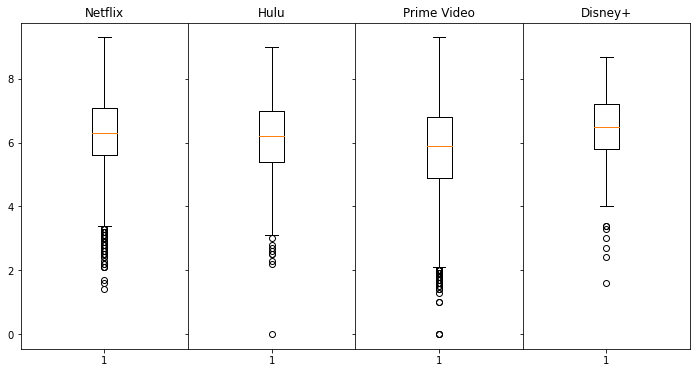

In [149]:
list_platforms=["Netflix","Hulu","Prime Video","Disney+"]
fig,(ax1,ax2,ax3,ax4)=plt.subplots(1,4,sharey=True,figsize=(12,6))
fig.subplots_adjust(hspace=0, wspace=0)
ax1.boxplot(new_data["IMDb"][new_data["Netflix"]==1])
ax1.title.set_text("Netflix")
ax2.boxplot(new_data["IMDb"][new_data["Hulu"]==1])
ax2.title.set_text("Hulu")
ax3.boxplot(new_data["IMDb"][new_data["Prime Video"]==1])
ax3.title.set_text("Prime Video")
ax4.boxplot(new_data["IMDb"][new_data["Disney+"]==1])
ax4.title.set_text("Disney+")

In [151]:
#Getting unique values of genres,directors and countries.
genres=movies_datas["Genres"].unique()
directors=movies_datas["Directors"].unique()
country=movies_datas['Country'].unique()
print(genres,directors,country)
#But as we can observe data set each of these have more than a single entity for almost each row . To make sure we don't repeat them in our unique value list we will 
#pick only different values out.
print(len(genres),len(directors),len(country))
final_genre=[]
for i in range(len(genres)):
    lis=list(map(str,genres[i].split(",")))
    for j in lis:
        if j not in final_genre:
            final_genre.append(j)

['Action,Adventure,Sci-Fi,Thriller' 'Action,Sci-Fi'
 'Action,Adventure,Sci-Fi' ... 'Comedy,Family,Fantasy,Mystery'
 'Family,Drama,Western' 'Comedy,Family,Adventure,Fantasy,Sci-Fi'] ['Christopher Nolan' 'Lana Wachowski,Lilly Wachowski'
 'Anthony Russo,Joe Russo' ... 'Dereck Joubert' 'Bruce Bilson'
 'Richard Slater-Jones'] ['United States,United Kingdom' 'United States' 'Italy,Spain,West Germany'
 ... 'Canada,Malaysia,United States' 'United States,Panama,Mexico'
 'United States,Hungary,United Kingdom']
1910 11339 1304


AttributeError: 'float' object has no attribute 'split'

In [152]:
final_genre

['Action',
 'Adventure',
 'Sci-Fi',
 'Thriller',
 'Comedy',
 'Western',
 'Animation',
 'Family',
 'Biography',
 'Drama',
 'Music',
 'War',
 'Crime',
 'Fantasy',
 'Romance',
 'History',
 'Mystery',
 'Horror',
 'Sport',
 'Documentary',
 'Musical',
 'News',
 'Short']

In [155]:
movie_each_year= movies_datas.loc[movies_datas.groupby("Year")["IMDb"].idxmax()].reset_index()
movie_each_year.drop('index',axis=1,inplace=True)
movie_each_year.loc[:,['Title','Year','IMDb']].head(50)

,Title,Year,IMDb
0,A Trip to the Moon,1902,8.2
1,From the Manger to the Cross,1912,5.7
2,Fatty Joins the Force,1913,5.3
3,The Birth of a Nation,1915,6.4
4,Intolerance: Love's Struggle Throughout the Ages,1916,7.8
5,A Romance of the Redwoods,1917,5.7
6,Stella Maris,1918,6.7
7,Broken Blossoms,1919,7.3
8,The Cabinet of Dr. Caligari,1920,8.1
9,Orphans of the Storm,1921,7.4


<AxesSubplot:xlabel='IMDb', ylabel='Year'>

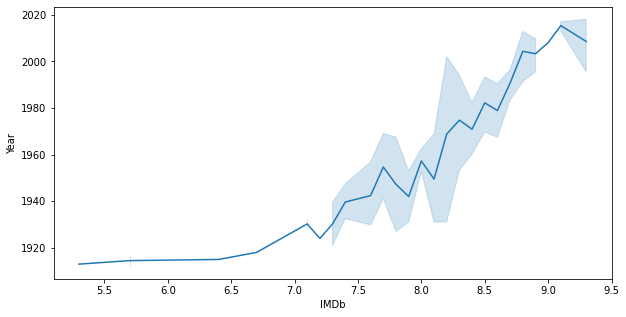

In [156]:
#Change of best movie rating over the years
plt.figure(figsize=(10,5))
sns.lineplot(x='IMDb',y='Year',data=movie_each_year)

<AxesSubplot:xlabel='Runtime', ylabel='IMDb'>

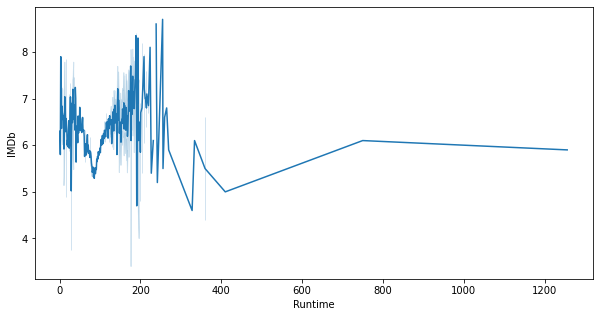

In [158]:
#Effect of runtime on rating
plt.figure(figsize=(10,5))
sns.lineplot(x='Runtime',y='IMDb',data=movies_datas)

In [174]:
movies_datas['Service Provider'] = movies_datas.loc[:,['Netflix','Prime Video','Disney+','Hulu']].idxmax(axis=1)
movies_datas.drop(['Netflix','Prime Video','Disney+','Hulu'],axis=1)

,Unnamed: 0,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Type,Directors,Genres,Country,Language,Runtime,Service Provider
0,0,1,Inception,2010,13+,8.8,87%,0,Christopher Nolan,"Action,Adventure,Sci-Fi,Thriller","United States,United Kingdom","English,Japanese,French",148.0,Netflix
1,1,2,The Matrix,1999,18+,8.7,87%,0,"Lana Wachowski,Lilly Wachowski","Action,Sci-Fi",United States,English,136.0,Netflix
2,2,3,Avengers: Infinity War,2018,13+,8.5,84%,0,"Anthony Russo,Joe Russo","Action,Adventure,Sci-Fi",United States,English,149.0,Netflix
3,3,4,Back to the Future,1985,7+,8.5,96%,0,Robert Zemeckis,"Adventure,Comedy,Sci-Fi",United States,English,116.0,Netflix
4,4,5,"The Good, the Bad and the Ugly",1966,18+,8.8,97%,0,Sergio Leone,Western,"Italy,Spain,West Germany",Italian,161.0,Netflix
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16739,16739,16740,The Ghosts of Buxley Hall,1980,NaN,6.2,NaN,0,Bruce Bilson,"Comedy,Family,Fantasy,Horror",United States,English,120.0,Disney+
16740,16740,16741,The Poof Point,2001,7+,4.7,NaN,0,Neal Israel,"Comedy,Family,Sci-Fi",United States,English,90.0,Disney+
16741,16741,16742,Sharks of Lost Island,2013,NaN,5.7,NaN,0,Neil Gelinas,Documentary,United States,English,NaN,Disney+
16742,16742,16743,Man Among Cheetahs,2017,NaN,6.6,NaN,0,Richard Slater-Jones,Documentary,United States,English,NaN,Disney+


<AxesSubplot:xlabel='IMDb', ylabel='Service Provider'>

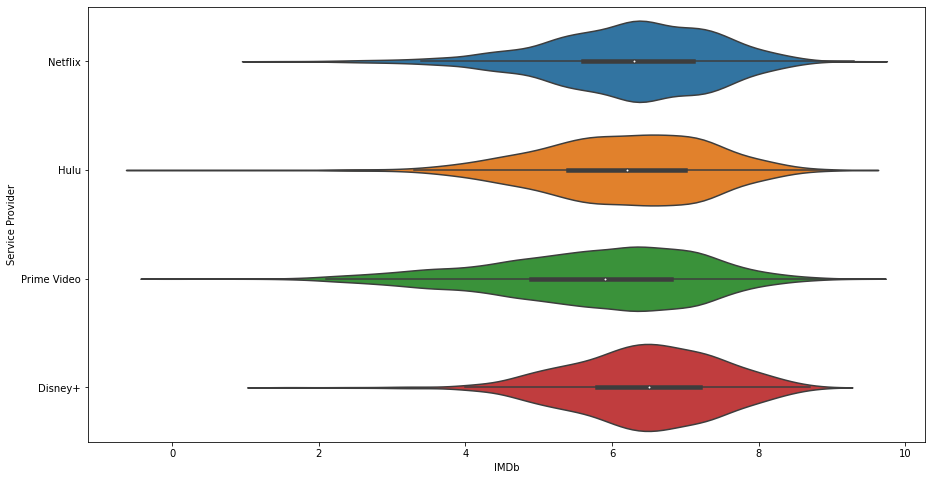

In [177]:
#Distribution of movie rating in each platform
plt.figure(figsize=(15,8))
sns.violinplot(x=movies_datas['IMDb'],y=movies_datas['Service Provider'])

In [182]:
#Average Runtime length of each ott platform
movies_datas.groupby("Service Provider")["Runtime"].mean()

Service Provider
Disney+        89.571157
Hulu           95.391374
Netflix        98.912900
Prime Video    91.904872
Name: Runtime, dtype: float64

In [183]:
#Average IMDb rating of each ott platform
movies_datas.groupby("Service Provider")["IMDb"].mean()

Service Provider
Disney+        6.440187
Hulu           6.152698
Netflix        6.252963
Prime Video    5.760055
Name: IMDb, dtype: float64

In [186]:
#Top 10 movies
movies_datas.sort_values('IMDb',ascending=False)[:10].reset_index().drop(['ID','index','Country','Language','Type','Rotten Tomatoes'],axis=1)

,Unnamed: 0,Title,Year,Age,IMDb,Netflix,Hulu,Prime Video,Disney+,Directors,Genres,Runtime,Service Provider
0,1292,My Next Guest with David Letterman and Shah Ru...,2019,NaN,9.3,1,0,0,0,NaN,Talk-Show,61.0,Netflix
1,7220,"Down, But Not Out!",2015,NaN,9.3,0,0,1,0,Miguel Gaudêncio,"Documentary,Sport",68.0,Prime Video
2,6566,Square One,2019,NaN,9.3,0,0,1,0,Danny Wu,"Documentary,Drama,Music",83.0,Prime Video
3,5110,Love on a Leash,2011,NaN,9.3,0,0,1,0,Fen Tian,"Comedy,Drama,Fantasy,Romance",90.0,Prime Video
4,6837,Steven Banks: Home Entertainment Center,1989,NaN,9.3,0,0,1,0,Tom McLoughlin,Comedy,60.0,Prime Video
5,7426,Bounty,2011,NaN,9.3,0,0,1,0,Roger Donaldson,"Adventure,Drama,History,Romance",132.0,Prime Video
6,8458,Where's Daddy?,2017,NaN,9.1,0,0,1,0,Rel Dowdell,Documentary,105.0,Prime Video
7,947,Natsamrat,2016,NaN,9.1,1,0,0,0,Mahesh Manjrekar,"Drama,Family",166.0,Netflix
8,7491,Finding Family,2013,13+,9.1,0,0,1,0,"Chris Leslie,Oggi Tomic","Documentary,Family,History,War",56.0,Prime Video
9,7267,A Dog Named Gucci,2015,NaN,9.0,0,0,1,0,Gorman Bechard,"Documentary,Biography,Drama,News",90.0,Prime Video


In [187]:
top_rated_movies = movies_data.sort_values('IMDb',ascending = False).head(10)
fig = px.bar(top_rated_movies, x='Title', y='IMDb', color='IMDb', height=600)
fig.show()

In [188]:
top_directors = movies_data.groupby('Directors')['Title'].count().reset_index().rename(columns = {'Title':'Movie Count'}).sort_values('Movie Count',ascending = False).head(10)
fig = px.bar(top_directors, x='Directors', y='Movie Count', color='Movie Count', height=600)
fig.show()


In [190]:
#Top 10 movies of netflix
movies_datas[movies_datas['Service Provider']=='Netflix'].sort_values('IMDb',ascending=False)[:10].reset_index().drop(['ID','index','Country','Rotten Tomatoes','Language','Type'],axis=1)

,Unnamed: 0,Title,Year,Age,IMDb,Netflix,Hulu,Prime Video,Disney+,Directors,Genres,Runtime,Service Provider
0,1292,My Next Guest with David Letterman and Shah Ru...,2019,NaN,9.3,1,0,0,0,NaN,Talk-Show,61.0,Netflix
1,947,Natsamrat,2016,NaN,9.1,1,0,0,0,Mahesh Manjrekar,"Drama,Family",166.0,Netflix
2,4,"The Good, the Bad and the Ugly",1966,18+,8.8,1,0,1,0,Sergio Leone,Western,161.0,Netflix
3,0,Inception,2010,13+,8.8,1,0,0,0,Christopher Nolan,"Action,Adventure,Sci-Fi,Thriller",148.0,Netflix
4,1214,Bill Hicks: Relentless,1992,NaN,8.7,1,0,0,0,Chris Bould,"Documentary,Comedy",61.0,Netflix
5,1311,Eh Janam Tumhare Lekhe,2015,NaN,8.7,1,0,0,0,Harjit Singh,Biography,135.0,Netflix
6,1,The Matrix,1999,18+,8.7,1,0,0,0,"Lana Wachowski,Lilly Wachowski","Action,Sci-Fi",136.0,Netflix
7,1979,One Heart: The A.R. Rahman Concert Film,2017,NaN,8.7,1,0,0,0,"Deepak Gattani,Ym Movies","Documentary,Music",87.0,Netflix
8,1458,Untamed Romania,2018,7+,8.7,1,0,1,0,Tom Barton-Humphreys,Documentary,92.0,Netflix
9,1356,Merku Thodarchi Malai,2018,NaN,8.6,1,0,0,0,Leninbharati,Drama,122.0,Netflix


In [191]:
#Top 10 movies of netflix
movies_datas[movies_datas['Service Provider']=='Prime Video'].sort_values('IMDb',ascending=False)[:10].reset_index().drop(['ID','index','Country','Rotten Tomatoes','Language','Type'],axis=1)

,Unnamed: 0,Title,Year,Age,IMDb,Netflix,Hulu,Prime Video,Disney+,Directors,Genres,Runtime,Service Provider
0,6837,Steven Banks: Home Entertainment Center,1989,NaN,9.3,0,0,1,0,Tom McLoughlin,Comedy,60.0,Prime Video
1,5110,Love on a Leash,2011,NaN,9.3,0,0,1,0,Fen Tian,"Comedy,Drama,Fantasy,Romance",90.0,Prime Video
2,7426,Bounty,2011,NaN,9.3,0,0,1,0,Roger Donaldson,"Adventure,Drama,History,Romance",132.0,Prime Video
3,7220,"Down, But Not Out!",2015,NaN,9.3,0,0,1,0,Miguel Gaudêncio,"Documentary,Sport",68.0,Prime Video
4,6566,Square One,2019,NaN,9.3,0,0,1,0,Danny Wu,"Documentary,Drama,Music",83.0,Prime Video
5,7491,Finding Family,2013,13+,9.1,0,0,1,0,"Chris Leslie,Oggi Tomic","Documentary,Family,History,War",56.0,Prime Video
6,8458,Where's Daddy?,2017,NaN,9.1,0,0,1,0,Rel Dowdell,Documentary,105.0,Prime Video
7,7267,A Dog Named Gucci,2015,NaN,9.0,0,0,1,0,Gorman Bechard,"Documentary,Biography,Drama,News",90.0,Prime Video
8,7002,Escape from Firebase Kate,2015,NaN,9.0,0,0,1,0,Paul Kakert,Documentary,60.0,Prime Video
9,6840,Peter Gabriel: Secret World Live,1993,all,8.9,0,0,1,0,François Girard,"Documentary,Music",102.0,Prime Video


In [192]:
#Top 10 movies of netflix
movies_datas[movies_datas['Service Provider']=='Disney+'].sort_values('IMDb',ascending=False)[:10].reset_index().drop(['ID','index','Country','Rotten Tomatoes','Language','Type'],axis=1)

,Unnamed: 0,Title,Year,Age,IMDb,Netflix,Hulu,Prime Video,Disney+,Directors,Genres,Runtime,Service Provider
0,16213,Star Wars: The Empire Strikes Back,1980,7+,8.7,0,0,0,1,Irvin Kershner,"Action,Adventure,Fantasy,Sci-Fi",124.0,Disney+
1,16212,Star Wars: A New Hope,1977,7+,8.6,0,0,0,1,George Lucas,"Action,Adventure,Fantasy,Sci-Fi",121.0,Disney+
2,16441,Newsies: The Broadway Musical,2017,13+,8.5,0,0,0,1,"Jeff Calhoun,Brett Sullivan",Musical,149.0,Disney+
3,16214,The Lion King,1994,all,8.5,0,0,0,1,Jon Favreau,"Animation,Adventure,Drama,Family,Musical",118.0,Disney+
4,16217,WALL·E,2008,all,8.4,0,0,0,1,Andrew Stanton,"Animation,Adventure,Family,Sci-Fi",98.0,Disney+
5,16221,Coco,2017,7+,8.4,0,0,0,1,"Lee Unkrich,Adrian Molina","Animation,Adventure,Family,Fantasy,Music,Mystery",105.0,Disney+
6,16216,Avengers: Endgame,2019,13+,8.4,0,0,0,1,"Anthony Russo,Joe Russo","Action,Adventure,Drama,Sci-Fi",181.0,Disney+
7,16224,Star Wars: Return of the Jedi,1983,7+,8.3,0,0,0,1,Richard Marquand,"Action,Adventure,Fantasy,Sci-Fi",131.0,Disney+
8,16222,Toy Story 3,2010,all,8.3,0,0,0,1,Lee Unkrich,"Animation,Adventure,Comedy,Family,Fantasy",103.0,Disney+
9,16582,Phineas and Ferb: Mission Marvel,2013,all,8.3,0,0,0,1,"Robert Hughes,Sue Perrotto","Animation,Action,Comedy,Family,Musical,Sci-Fi",45.0,Disney+


In [57]:
#Extracting the countries
country=[]
for i in range(len(movies_data)):
    x=movies_data['Country'][i]
    y=x.split(',')
    for j in range(len(y)):
        country.append(y[j])
        
country_c = Counter(country)
country_c_15=OrderedDict(country_c.most_common()[:15])

#Countries with most movies
data = [go.Bar(
   x = list(country_c_15.keys()),
   y = list(country_c_15.values())
)]
fig = go.Figure(data=data)
iplot(fig)

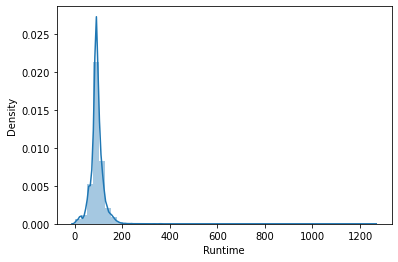

In [201]:
#Most of the movies have about 90-100 minutes of runtime. Runtime is positively skewed since there are some movies with very large runtime.
sns.distplot(movies_datas['Runtime']);

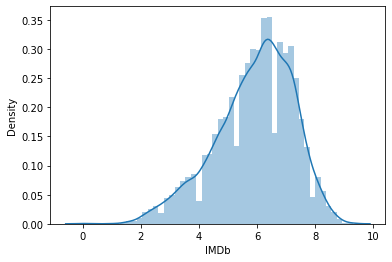

In [198]:
#IMDb ratings of the movies roughly follows normal distribution with mean of about 6.5
sns.distplot(movies_datas['IMDb']);

In [210]:
movie_count_by_language = movies_data.groupby('Language')['Title'].count().reset_index().sort_values('Title',ascending = False).head(10).rename(columns = {'Title':'Movie Count'})
fig = px.bar(movie_count_by_language, x='Language', y='Movie Count', color='Movie Count', height=600)
fig.show()

In [211]:
movies_by_country = movies_data.groupby('Country')['Title'].count().reset_index().sort_values('Title',ascending = False).head(10).rename(columns = {'Title':'Movie Count'})
fig = px.bar(movies_by_country, x='Country', y='Movie Count', color='Movie Count', height=600)
fig.show()

In [69]:
top_genres = movies_data.groupby('Genres')['Title'].count().reset_index().rename(columns = {'Title':'Movie Count'}).sort_values('Movie Count',ascending = False).head(10)
fig = px.bar(top_genres, x='Genres', y='Movie Count', color='Movie Count', height=600)
fig.show()

In [212]:

netflix_movies = movies_datas.loc[movies_data['Netflix'] == 1]
hulu_movies = movies_datas.loc[movies_data['Hulu'] == 1]
prime_video_movies = movies_datas.loc[movies_data['Prime Video'] == 1]
disney_movies = movies_data.loc[movies_data['Disney+'] == 1]

In [213]:
netflix_movies.drop(['Hulu', 'Prime Video', 'Disney+', 'Type','Genres'], axis = 1)
hulu_movies.drop(['Netflix', 'Prime Video', 'Disney+', 'Type','Genres'], axis = 1)
prime_video_movies.drop(['Hulu', 'Netflix', 'Disney+', 'Type','Genres'], axis = 1)
disney_movies.drop(['Hulu', 'Prime Video', 'Netflix', 'Type','Genres'], axis = 1)

,Unnamed: 0,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Disney+,Directors,Country,Language,Runtime
95,95,96,Saving Mr. Banks,2013,13+,7.5,79%,1,John Lee Hancock,"United States,United Kingdom,Australia",English,125.0
103,103,104,Amy,2015,18+,7.8,95%,1,NaN,United States,English,60.0
122,122,123,Bolt,2008,7+,6.8,89%,1,"Byron Howard,Chris Williams",United States,English,96.0
125,125,126,The Princess and the Frog,2009,all,7.1,85%,1,"Ron Clements,John Musker",United States,"English,French",97.0
150,150,151,Miracle,2004,7+,7.5,81%,1,Gavin O'Connor,"Canada,United States",English,135.0
...,...,...,...,...,...,...,...,...,...,...,...,...
16739,16739,16740,The Ghosts of Buxley Hall,1980,NaN,6.2,NaN,1,Bruce Bilson,United States,English,120.0
16740,16740,16741,The Poof Point,2001,7+,4.7,NaN,1,Neal Israel,United States,English,90.0
16741,16741,16742,Sharks of Lost Island,2013,NaN,5.7,NaN,1,Neil Gelinas,United States,English,NaN
16742,16742,16743,Man Among Cheetahs,2017,NaN,6.6,NaN,1,Richard Slater-Jones,United States,English,NaN


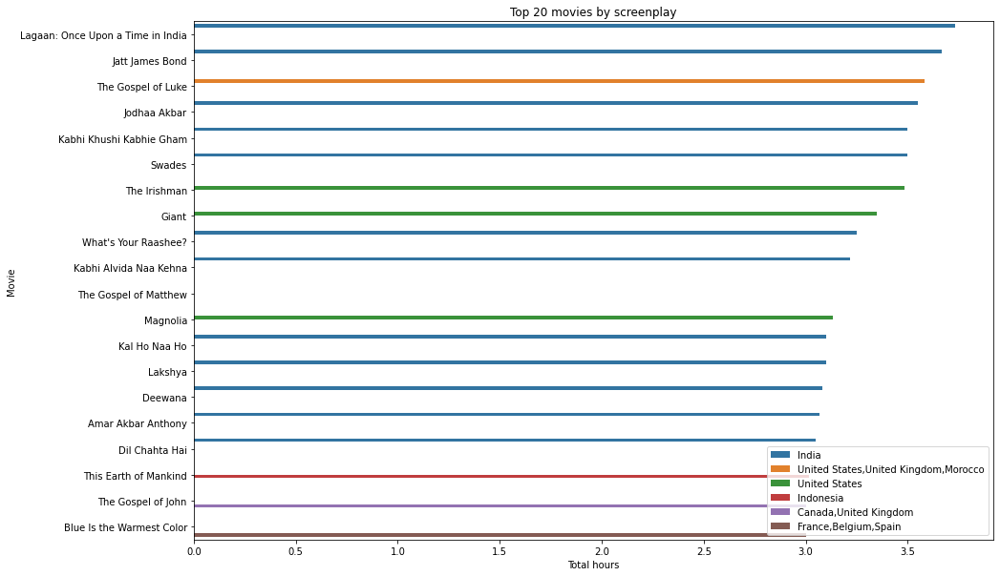

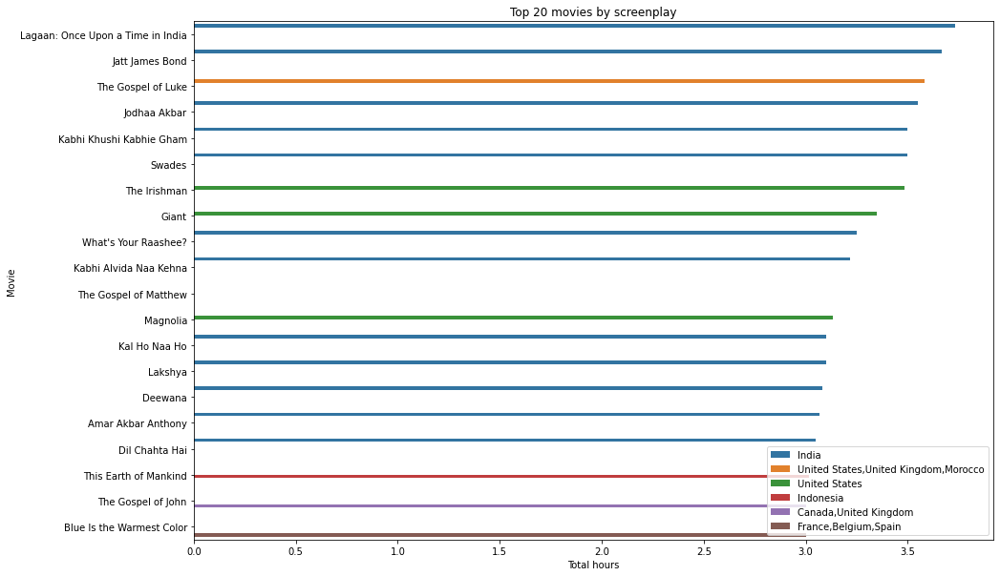

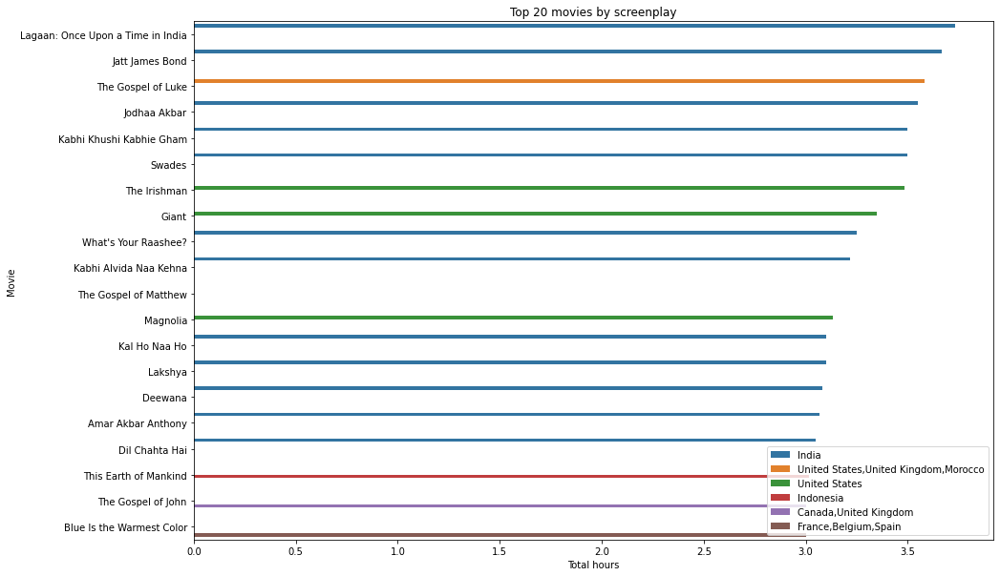

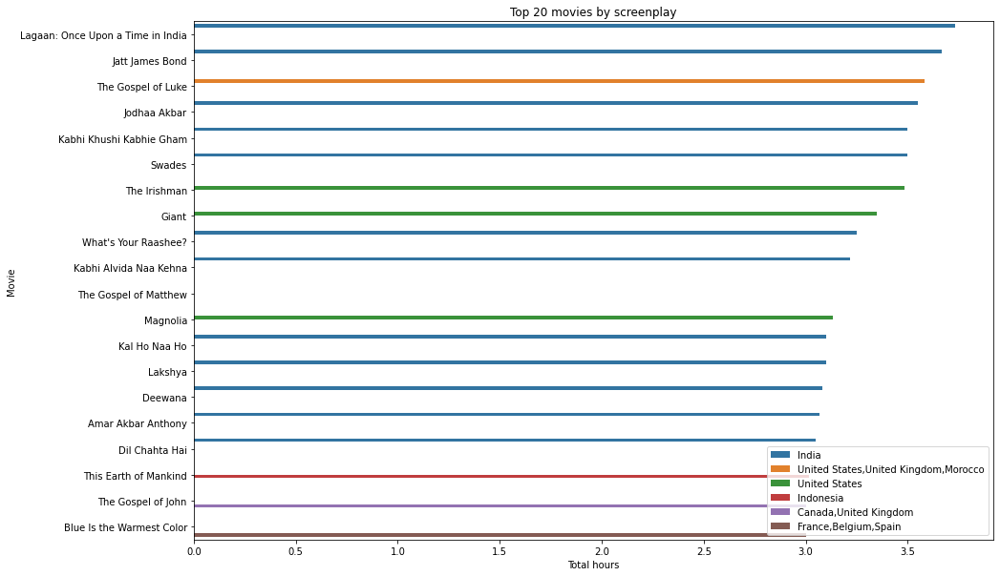

In [214]:
# Getting screenplay in hours
netflix_movies['screenplay'] = netflix_movies['Runtime']/60
hulu_movies['screenplay'] = hulu_movies['Runtime'] / 60
prime_video_movies['screenplay'] = prime_video_movies['Runtime'] / 60
disney_movies['screenplay'] = disney_movies['Runtime'] / 60


# Creating function to get screenplay of top 20 movies on desired platform
def top_20_sp(platform):
    top_20_screenplay=netflix_movies.sort_values(by='screenplay',ascending=False).head(20)
    plt.figure(figsize=(15,10))
    sns.barplot(x='screenplay',y='Title',data=top_20_screenplay,hue='Country')
    plt.legend(loc='lower right')
    plt.xlabel('Total hours')
    plt.ylabel('Movie')
    plt.title('Top 20 movies by screenplay')
    plt.show()
    
top_20_sp(netflix_movies)
top_20_sp(disney_movies)
top_20_sp(prime_video_movies)
top_20_sp(hulu_movies)

In [16]:
n = 30

top_ratings = movies_data.sort_values(by="IMDb",ascending=False).reset_index().iloc[:n]

fig = px.bar(top_ratings,
             x = "Title", y='IMDb',
             color='IMDb',
             hover_data=["Directors","IMDb"],
             title=f"Top {n} best rated movies",
             height=1000,
             color_continuous_scale=px.colors.sequential.Viridis)
fig.show()

In [217]:
#We often hear that nowadays they don´t make films as they used to... as if today´s films were not as good as the ones filmed years ago. Let´s see if that's entirely true...
df_year = movies_data.groupby("Year").mean()
df_year.drop(["Unnamed: 0","ID",'Netflix', 'Hulu', 'Prime Video', 'Disney+', 'Type'],inplace=True,axis=1)
df_year["Movie Count"] = movies_data.groupby("Year").count()["ID"]
df_year.head()

,IMDb,Runtime,Movie Count
Year,,,
1902,8.20,13.0,1
1912,5.70,60.0,1
1913,5.15,10.0,2
1915,5.55,73.5,4
1916,7.80,163.0,1


In [218]:
# Add a new column to our dataframe that indicates how many movies were made that year

# Get a dictionary from the df_year dataframe, where keys=year and values=movies made

d = df_year["Movie Count"].to_dict()
d.pop('IMDb', None)
d.pop("Runtime",None)

# Create our new column using the map function

movies_datas['Movie Count'] = movies_data['Year'].map(d)
movies_datas.head()

,Unnamed: 0,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Netflix,Hulu,Prime Video,Disney+,Type,Directors,Genres,Country,Language,Runtime,Movie Count
0,0,1,Inception,2010,13+,8.8,87%,1,0,0,0,0,Christopher Nolan,"Action,Adventure,Sci-Fi,Thriller","United States,United Kingdom","English,Japanese,French",148.0,533
1,1,2,The Matrix,1999,18+,8.7,87%,1,0,0,0,0,"Lana Wachowski,Lilly Wachowski","Action,Sci-Fi",United States,English,136.0,149
2,2,3,Avengers: Infinity War,2018,13+,8.5,84%,1,0,0,0,0,"Anthony Russo,Joe Russo","Action,Adventure,Sci-Fi",United States,English,149.0,1285
3,3,4,Back to the Future,1985,7+,8.5,96%,1,0,0,0,0,Robert Zemeckis,"Adventure,Comedy,Sci-Fi",United States,English,116.0,66
4,4,5,"The Good, the Bad and the Ugly",1966,18+,8.8,97%,1,0,1,0,0,Sergio Leone,Western,"Italy,Spain,West Germany",Italian,161.0,28


<AxesSubplot:xlabel='Year', ylabel='IMDb'>

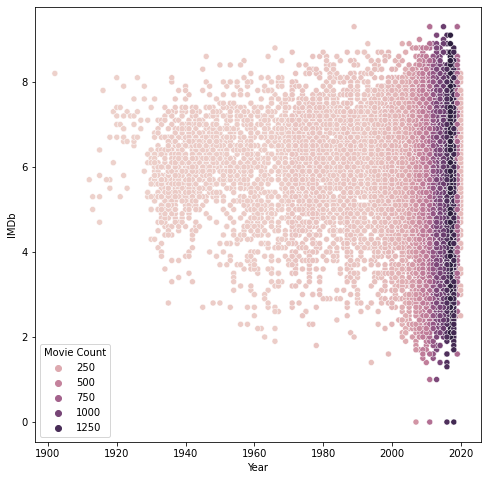

In [220]:
#From now on we can add visual information to our plots that will remind us of how many movies were made on a certain year
x = movies_data["Year"]
y = movies_data["IMDb"]

plt.figure(figsize=(8,8))
sns.scatterplot(x,y,data=movies_datas,hue="Movie Count")

In [26]:
Rating = df_year["IMDb"]
Year = df_year.index

fig = px.line(df_year, x=Year, y=Rating, 
              line_shape="spline", render_mode="svg",
              hover_name=movies_data.groupby("Year").mean().index,
              title="Average Movie Ratings 1902-2020")
fig.show()

In [27]:
fig = px.box(movies_data, x="Year", y="IMDb",color="Year")
fig.show()

In [28]:
fig = px.scatter(movies_data,x="Runtime", y="IMDb",color="Year",
                 marginal_x="histogram",
                 marginal_y="histogram",
                 hover_name="Title",hover_data=["Age"])
fig.show()

In [29]:
height = 800

fig2 = px.scatter(movies_data.dropna(),x="Runtime", y="IMDb",color="Age",
                marginal_x="histogram",
                hover_name="Title",hover_data=["Year"],
                height=height)

fig1 = px.scatter(movies_data.dropna(),x="Year", y="IMDb",color="Age",
                marginal_x="histogram",
                hover_name="Title",hover_data=["Runtime"],
                height=height)
fig1.show()
fig2.show()

In [30]:
 #Create a new dataframe specific for directors and the number of movies they directed

directors = pd.DataFrame(movies_data.groupby(["Directors"]).count()["ID"])
directors["No. of Films"] = directors["ID"]
directors.drop(["ID"],axis=1,inplace=True)

In [31]:
n = 40
data = directors.sort_values(by="No. of Films",ascending=False).reset_index().iloc[:n]

fig = px.bar(data,
             x = "Directors", y='No. of Films',
             color='No. of Films',
             title=f"Top {n} directors with most directed movies")
fig.show()

In [32]:
# Directors who directed the best and worst IMDb ranked movies

n = 30
x="Directors"

data1 = movies_data.groupby(by="Directors").mean().sort_values(by="IMDb",ascending=False).reset_index().iloc[:n]
data2 = movies_data.groupby(by="Directors").mean().sort_values(by="IMDb",ascending=True).reset_index().iloc[2:n]

# For the worst IMDb average we droped the worst two because they had an average of 0 and it´s not considered representative

fig = px.bar(data1,x=data1["Directors"],y=data1["IMDb"],color="IMDb",
             title=f"Top {n} Directors with the highest averaged movie ratings")
fig.show()

fig = px.bar(data2,x=data2["Directors"],y=data2["IMDb"],color="IMDb",
            title=f"Top {n} Directors with the lowest averaged movie ratings")
fig.show()

In [33]:
# Directors who directed the longest and shortest movies

n = 30
x="Directors"

data1 = movies_data.groupby(by="Directors").mean().sort_values(by="Runtime",ascending=False).reset_index().iloc[:n]
data2 = movies_data.groupby(by="Directors").mean().sort_values(by="Runtime",ascending=True).reset_index().iloc[:n]

# For the worst IMDb average we droped the worst two because they had an average of 0 and it´s not considered representative

fig = px.bar(data1,x=data1["Directors"],y=data1["Runtime"],color="Runtime",
             title=f"Top {n} Directors with longest average runtime for directed movies")
fig.show()

fig = px.bar(data2,x=data2["Directors"],y=data2["Runtime"],color="Runtime",
            title=f"Top {n} Directors with shortest average runtime for directed movies")
fig.show()

In [37]:
# Let´s turn this into a dataframe so that we can plot it

genres = pd.DataFrame.from_dict(d, orient='index').reset_index()
genres["Genre"] = genres["index"]
genres["Count"] = genres[0]
genres.drop(["index",0],axis=1,inplace=True)
genres.head()

,Genre,Count
0,1902,1
1,1912,1
2,1913,2
3,1915,4
4,1916,1


In [43]:
mixed_genres = []
for i in movies_data["Genres"].dropna():
    if "," in i:
        mixed_genres.append(i)

d = Counter(mixed_genres)

print(f"We found a total of {len(d)} different genres")

# Create dataframe

df_mixedg = pd.DataFrame.from_dict(d, orient='index').reset_index()
df_mixedg["Genre"] = df_mixedg["index"]
df_mixedg["Count"] = df_mixedg[0]
df_mixedg.drop(["index",0],axis=1,inplace=True)
df_mixedg.head()

We found a total of 1883 different genres


,Genre,Count
0,"Action,Adventure,Sci-Fi,Thriller",35
1,"Action,Sci-Fi",46
2,"Action,Adventure,Sci-Fi",48
3,"Adventure,Comedy,Sci-Fi",6
4,"Animation,Action,Adventure,Family,Sci-Fi",5


In [44]:
n = 30

# 3. Most common mixed genres.

fig = px.pie(df_mixedg.sort_values(by="Count",ascending=False).reset_index().iloc[:n], values='Count', names='Genre', 
             title=f"Top {n} most common movie mixed genres")
fig.show()

In [47]:
all_genres = []

for genre in movies_data["Genres"].dropna():
    movie_genres = genre.split(",")
    for i in movie_genres:
        all_genres.append(i)

In [48]:
df_genre_year = pd.DataFrame(index=range(1902,2021),columns=Counter(all_genres).keys())
#df_genre_year.astype("float64")
df_genre_year.head()

,Action,Adventure,Sci-Fi,Thriller,Comedy,Western,Animation,Family,Biography,Drama,...,Horror,Sport,Documentary,Musical,News,Short,Reality-TV,Talk-Show,Game-Show,Film-Noir
1902,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1903,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1904,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1905,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1906,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [51]:
for year in range(1902,2021):
    genre_year = []
    for genres in movies_data[movies_data["Year"]==year]["Genres"].dropna():
        for i in genres.split(","):
            genre_year.append(i)

    d1 = Counter(genre_year)
    
    if len(d)==0:
        #df_genre_year.loc[year].fillna(0,inplace=True)
        pass
    
    df_genre_year.loc[year] = pd.Series(d1)

# Check some random years 
    
df_genre_year.loc[1928:1933]

,Action,Adventure,Sci-Fi,Thriller,Comedy,Western,Animation,Family,Biography,Drama,...,Horror,Sport,Documentary,Musical,News,Short,Reality-TV,Talk-Show,Game-Show,Film-Noir
1928,1,NaN,NaN,NaN,3,NaN,1,2,NaN,2,...,NaN,NaN,NaN,1,NaN,1,NaN,NaN,NaN,NaN
1929,1,1,NaN,2,2,NaN,NaN,1,NaN,4,...,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN
1930,2,1,NaN,1,8,1,NaN,1,2,4,...,NaN,NaN,NaN,1,NaN,1,NaN,NaN,NaN,NaN
1931,3,5,NaN,NaN,8,3,NaN,NaN,NaN,6,...,NaN,NaN,NaN,1,NaN,2,NaN,NaN,NaN,NaN
1932,7,6,1,6,10,3,1,2,NaN,11,...,3,1,NaN,1,NaN,2,NaN,NaN,NaN,NaN
1933,9,4,1,6,8,8,NaN,NaN,1,20,...,2,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN


<AxesSubplot:>

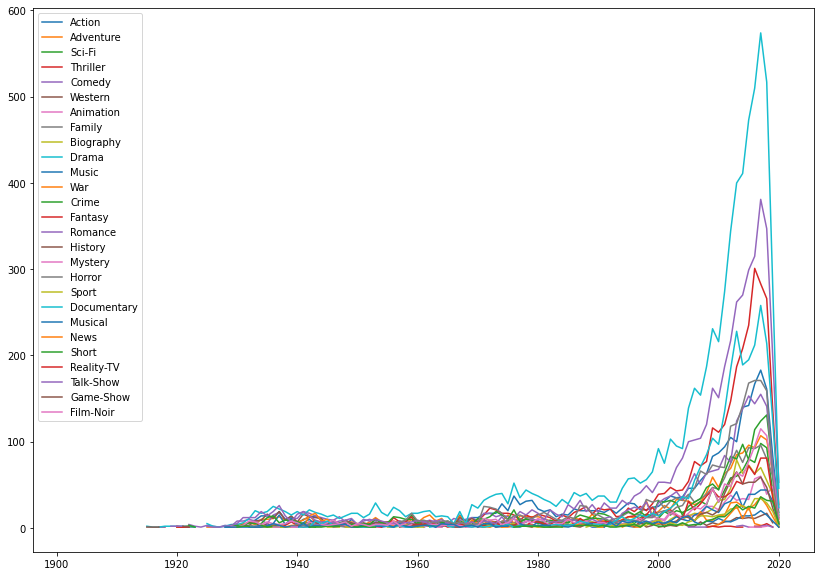

In [52]:
df_genre_year.plot(figsize=(14,10))

array([[<AxesSubplot:title={'center':'ID'}>,
        <AxesSubplot:title={'center':'Year'}>,
        <AxesSubplot:title={'center':'IMDb'}>],
       [<AxesSubplot:title={'center':'Netflix'}>,
        <AxesSubplot:title={'center':'Hulu'}>,
        <AxesSubplot:title={'center':'Prime Video'}>],
       [<AxesSubplot:title={'center':'Disney+'}>,
        <AxesSubplot:title={'center':'Type'}>,
        <AxesSubplot:title={'center':'Runtime'}>],
       [<AxesSubplot:title={'center':'Movie Count'}>, <AxesSubplot:>,
        <AxesSubplot:>]], dtype=object)

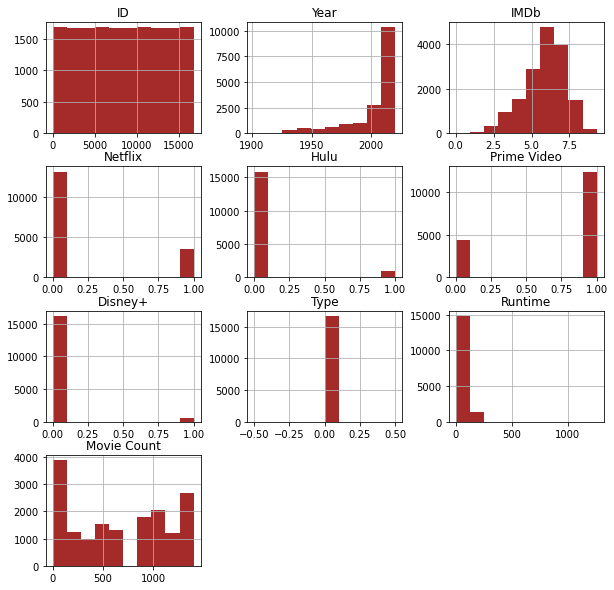

In [57]:
movies_data.hist(color='brown',figsize=(10,10))

In [59]:
df_year = pd.DataFrame(movies_data.groupby(movies_data['Year']).Title.nunique())
df_year.nlargest(5,'Title')

,Title
Year,
2017,1401
2018,1285
2016,1206
2015,1065
2014,986


In [60]:
df_year.nsmallest(5,'Title')

,Title
Year,
1902,1
1912,1
1916,1
1917,1
1924,1


In [73]:
## Let's build a search function

def NextMovie(ScoreMovie,GenreMovie,YearMovie,LanguageMovie):
    possiblemovie1=movies_data.loc[movies_data['IMDb']>(ScoreMovie)]
    possiblemovie2=possiblemovie1.loc[movies_data['Genres'].str.contains(GenreMovie, na=False)]
    possiblemovie3=possiblemovie2.loc[movies_data['Year']>(YearMovie)]
    possiblemovie4=possiblemovie3.loc[movies_data['Language'].str.contains(LanguageMovie, na=False)]
    try:
      print(possiblemovie4['Title'])
    except:
      print("I\'m so sorry, no Title available, try to change parameters")

In [5]:
#On Which Platform is this Movie Available?
def Availability(title):
    
    NetflixAvailable=Netflix.loc[Netflix['Title']==(title)]
    PrimeVideoAvailable=PrimeVideo.loc[PrimeVideo['Title']==(title)]
    DisneyAvailable=PrimeVideo.loc[PrimeVideo['Title']==(title)]
    HuluAvailable=PrimeVideo.loc[PrimeVideo['Title']==(title)]
   
        
    if (len(NetflixAvailable) >0):
            print('It is available on Netflix')
    else:
            print('It is not Available on Netflix')

    if (len(PrimeVideoAvailable) >0):
            print('It is available on PrimeVideo')
    else:
            print('It is not Available on PrimeVideo')

    if (len(DisneyAvailable) >0):
            print('It is available on Disney+')
    else:
            print('It is not Available on Disney+')

    if (len(HuluAvailable) >0):
            print('It is available on Hulu')
    else:
            print('It is not Available on Hulu')
        

In [6]:
###Divide the DataSet according to the Platform
Netflix=movies_data[movies_data['Netflix']>0][['Title','Age','IMDb','Year','Directors','Genres','Country','Language','Runtime']]
PrimeVideo=movies_data[movies_data['Prime Video']>0][['Title','Age','IMDb','Year','Directors','Genres','Country','Language','Runtime']]
Hulu=movies_data[movies_data['Hulu']>0][['Title','Age','IMDb','Year','Directors','Genres','Country','Language','Runtime']]
Disney=movies_data[movies_data['Disney+']>0][['Title','Age','IMDb','Year','Directors','Genres','Country','Language','Runtime']]

In [8]:
###Example
title=input("Enter the title")
Availability(title)

Enter the titleInception
It is available on Netflix
It is not Available on PrimeVideo
It is not Available on Disney+
It is not Available on Hulu


In [6]:
movies_data = pd.melt(movies_data, id_vars = ['ID', 'Title', 'Year', 'Age', 'IMDb', 'Rotten Tomatoes', 'Type', 'Directors', 'Genres', 'Country', 'Language'], 
        value_vars = ['Netflix', 'Hulu', 'Prime Video', 'Disney+'], var_name = 'Streaming Platform')
movies_data = movies_data[movies_data['value'] == 1].drop(['value', 'Type'], axis = 1) #Type is being dropped here because the value will always be 0, since the whole dataset represents only movies
movies_data.head()

,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Directors,Genres,Country,Language,Streaming Platform
0,1,Inception,2010,13+,8.8,87%,Christopher Nolan,"Action,Adventure,Sci-Fi,Thriller","United States,United Kingdom","English,Japanese,French",Netflix
1,2,The Matrix,1999,18+,8.7,87%,"Lana Wachowski,Lilly Wachowski","Action,Sci-Fi",United States,English,Netflix
2,3,Avengers: Infinity War,2018,13+,8.5,84%,"Anthony Russo,Joe Russo","Action,Adventure,Sci-Fi",United States,English,Netflix
3,4,Back to the Future,1985,7+,8.5,96%,Robert Zemeckis,"Adventure,Comedy,Sci-Fi",United States,English,Netflix
4,5,"The Good, the Bad and the Ugly",1966,18+,8.8,97%,Sergio Leone,Western,"Italy,Spain,West Germany",Italian,Netflix


In [7]:
#Now, we have the data ready for some analysis, even though we can still do processing on the other rows, as Directors, Genres, Country and Language, but we will do that later.

#So, which platform has the most movies to offer?
movies_count = movies_data.groupby('Streaming Platform', as_index = False).count()
movies_count = movies_count[['Streaming Platform', 'ID']].rename({'ID' : 'Count'}, axis = 'columns')
movies_count = movies_count.sort_values(by = 'Count', ascending = False)
color_map={
    "Prime Video": "rgb(4, 165, 222)",
    "Netflix": "rgb(223, 9, 18)",
    "Hulu": "rgb(2, 228, 119)",
    "Disney+": "rgb(0, 0, 0)"
}

import plotly.express as px

fig = px.bar(movies_count, y='Streaming Platform', x="Count", color="Streaming Platform", orientation="h",
             color_discrete_map= color_map, text = "Count"
            )

fig.update_layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    title="Number of movies offered by platform",
      xaxis_tickfont_size=14,
    yaxis=dict(
        title='Streaming Platform',
        titlefont_size=16,
        tickfont_size=14
    ),
    legend=dict(
        x=1,
        y=1.0,
        bgcolor='rgba(255, 255, 255, 0)',
        bordercolor='rgba(255, 255, 255, 0)'
    ),
)

fig.show()

In [9]:
#In this criteria we can see that Prime Video blows the competition away with almost 3/4 of the total motives offered by the platforms, followed by Netflix. Let's see if quantity corresponds also to quality.
list_of_sp = movies_count['Streaming Platform'].tolist()

movies_df_not_null = movies_data[~movies_data['IMDb'].isnull()]

fig = go.Figure()

rows_counter = 0
for sp, clr in zip(list_of_sp, color_map.values()):
        
        fig.add_trace(go.Box(
            x=movies_df_not_null[movies_df_not_null['Streaming Platform'] == sp]['Streaming Platform'],
            y=movies_df_not_null[movies_df_not_null['Streaming Platform'] == sp]['IMDb'],
            name=sp,
            boxpoints='all',
            jitter=0.5,
            whiskerwidth=0.2,
            fillcolor=clr,
            marker_size=2,
            line_width=1)
        )
        
        min_value = round(np.percentile(movies_df_not_null[movies_df_not_null['Streaming Platform'] == sp]['IMDb'], 0), 2)
        first_quartile = round(np.percentile(movies_df_not_null[movies_df_not_null['Streaming Platform'] == sp]['IMDb'], 25), 2)
        median = round(np.percentile(movies_df_not_null[movies_df_not_null['Streaming Platform'] == sp]['IMDb'], 50), 2)
        third_quartile = round(np.percentile(movies_df_not_null[movies_df_not_null['Streaming Platform'] == sp]['IMDb'], 75), 2)
        max_value = round(np.percentile(movies_df_not_null[movies_df_not_null['Streaming Platform'] == sp]['IMDb'], 100), 2)
        
        for y_desc, y_value in zip(('MinV: ', 'Q1: ', 'Med: ', 'Q3: ', 'MaxV: '), (min_value, first_quartile, median, third_quartile, max_value)):
        
            fig.add_annotation(
                        x=rows_counter + 0.35,
                        ax = 0,
                        ay = 0,
                        y=y_value,
                        text=y_desc + str(y_value))

        rows_counter += 1
        
fig.update_layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    title='Distribution of movies IMDb score by streaming platform',
    yaxis=dict(
        title='IMDb score',
        titlefont_size=16,
        tickfont_size=14
    ))

        
fig.show()

In [12]:
#Even though the data did not show that much of a discrepancy between the platforms as the last analysis, now Disney+ emerged as victorious, with a better distribution, in general, of IMDb scores for its movies, followed by Netflix. But, let's say you are not so much of a hard user and will only watch 1 movie per week, resulting in 52 movies per year. Which platform has the best 52 movies?
movies_data.sort_values(by = 'IMDb', ascending = False, inplace = True)
results_list = {}
for sp in movies_count['Streaming Platform'].tolist():
    sp_best_df = movies_data[movies_data['Streaming Platform'] == sp].head(n = 52)
    IMDb_mean = round(sp_best_df['IMDb'].mean(), 2)
    results_list[sp] = IMDb_mean
best_movies_df = pd.DataFrame.from_dict(results_list, orient = 'index', columns = ['AVG Score']).sort_values(by = 'AVG Score', ascending = True)


In [13]:
fig = px.bar(best_movies_df, y=best_movies_df.index, x="AVG Score", color=best_movies_df.index, orientation="h",
             color_discrete_map = color_map, text = "AVG Score"
            )

fig.update_layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    title="Average score of the best 52 movies by platform",
    xaxis_tickfont_size=14,
    yaxis=dict(
        title='Streaming Platform',
        titlefont_size=16,
        tickfont_size=14
    ),
    xaxis = dict(
        range = [best_movies_df['AVG Score'].min() - 0.1, best_movies_df['AVG Score'].max() + 0.1],
        title = "Average Score"
    ),
    legend=dict(
        x=1,
        y=1.0,
        bgcolor='rgba(255, 255, 255, 0)',
        bordercolor='rgba(255, 255, 255, 0)',
        title = 'Streaming Platform'
    ),
)

fig.show()

In [15]:
#Since we are working with a small number of movies, we can work with the average, since no outliers will mess up the numbers. Now we see a different pattern, similar to the number of movies offered by platform. Prime Video leading with Netflix right behing, and Hulu and Disney+ almost drawn. Now, let's see how are genres distributed. First, let's get the data in a easier way do deal with.
genres_split = movies_data['Genres'].str.get_dummies(',')
genres_movie_df = pd.concat([movies_data, genres_split], axis = 1)
genres_movie_df = pd.melt(genres_movie_df, id_vars = ['ID', 'Title', 'Year', 'Age', 'IMDb', 'Rotten Tomatoes', 'Directors', 'Genres', 'Country', 'Language', 'Streaming Platform'], 
        value_vars = genres_split.columns, var_name = 'Genre')
genres_movie_df = genres_movie_df[genres_movie_df['value'] == 1].drop(['value', 'Genres'], axis = 1)
genres_movie_df.head()

,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Directors,Country,Language,Streaming Platform,Genre
9,3561,The Dark Knight,2008,13+,9.0,94%,Christopher Nolan,"United States,United Kingdom","English,Mandarin",Hulu,Action
18,4830,The Mountain II,2016,all,8.9,NaN,Alper Caglar,Turkey,Turkish,Prime Video,Action
37,1,Inception,2010,13+,8.8,87%,Christopher Nolan,"United States,United Kingdom","English,Japanese,French",Netflix,Action
50,7085,RWBY: Volume 3,2016,13+,8.7,NaN,"Kerry Shawcross,Gray G. Haddock,Miles Luna",NaN,NaN,Prime Video,Action
59,16214,Star Wars: The Empire Strikes Back,1980,7+,8.7,94%,Irvin Kershner,United States,English,Disney+,Action


In [16]:
genres_count = genres_movie_df.groupby('Genre', as_index = False).count()
genres_count = genres_count[['Genre', 'ID']].rename({'ID' : 'Count'}, axis = 'columns')
genres_count = genres_count.sort_values(by = 'Count', ascending = False)

import plotly.express as px

fig = px.bar(genres_count.head(n = 15), y='Genre', x="Count", color='Genre', orientation="h", text = "Count"
            )

fig.update_layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    title="Number of movies segmented by genre",
    xaxis_tickfont_size=14,
    yaxis=dict(
        title='Movie genre',
        titlefont_size=16,
        tickfont_size=14
    ),
    legend=dict(
        x=1,
        y=1.0,
        bgcolor='rgba(255, 255, 255, 0)',
         bordercolor='rgba(255, 255, 255, 0)'
    ),
)

fig.show()

In [19]:
countries_split = movies_data['Country'].str.get_dummies(',')
countries_movie_df = pd.concat([movies_data, countries_split], axis = 1)
countries_movie_df = pd.melt(countries_movie_df, id_vars = ['ID', 'Title', 'Year', 'Age', 'IMDb', 'Rotten Tomatoes', 'Directors', 'Genres', 'Language', 'Streaming Platform'], 
        value_vars = countries_split.columns, var_name = 'Country')
countries_movie_df = countries_movie_df[countries_movie_df['value'] == 1].drop(['value'], axis = 1)
countries_movie_df
    

,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Directors,Genres,Language,Streaming Platform,Country
1969,7836,An Afghan Love Story,2013,NaN,7.4,NaN,Barmak Akram,Drama,Dari,Prime Video,Afghanistan
2231,10196,Access to the Danger Zone,2012,13+,7.3,NaN,"Peter Casaer,Eddie Gregoor","Documentary,History,War",English,Prime Video,Afghanistan
4413,5944,Manhunt: The Inside Story of the Hunt for Bin ...,2013,16+,6.9,57%,Greg Barker,"Documentary,History,War",English,Prime Video,Afghanistan
5543,5220,The Hornet's Nest,2014,18+,6.6,72%,"David Salzberg,Christian Tureaud","Documentary,Action,History,War",English,Prime Video,Afghanistan
23939,8738,Alive!,2009,NaN,6.4,NaN,Artan Minarolli,Drama,Albanian,Prime Video,Albania
...,...,...,...,...,...,...,...,...,...,...,...
2882858,13614,The One Eyed Soldiers,1966,NaN,4.1,NaN,John Ainsworth,"Action,Adventure,Crime",English,Prime Video,Yugoslavia
2883175,12731,Thor and the Amazon Women,1963,NaN,3.9,NaN,Antonio Leonviola,"Adventure,Drama,Fantasy","English,Italian",Prime Video,Yugoslavia
2898802,10682,Killing Heat,1981,13+,4.8,NaN,Michael Raeburn,Drama,English,Prime Video,Zambia
2905042,869,Trophy,2016,NaN,7.3,98%,"Christina Clusiau,Shaul Schwarz",Documentary,English,Netflix,Zimbabwe


In [23]:
countries_count = countries_movie_df.groupby('Country', as_index = False).count()
countries_count = countries_count[['Country', 'ID']].rename({'ID' : 'Count'}, axis = 'columns')
countries_count = countries_count.sort_values(by = 'Count', ascending = False)

import plotly.express as px

fig = px.bar(countries_count.head(n = 15), y='Country', x="Count", color='Country', orientation="h", text = "Count"
            )

fig.update_layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    title="Number of movies segmented by country",
    xaxis_tickfont_size=14,
    yaxis=dict(
        title='Movie genre',
        titlefont_size=16,
        tickfont_size=14
    ),
    legend=dict(
        x=1,
        y=1.0,
        bgcolor='rgba(255, 255, 255, 0)',
        bordercolor='rgba(255, 255, 255, 0)'
    ),
)
fig.show()

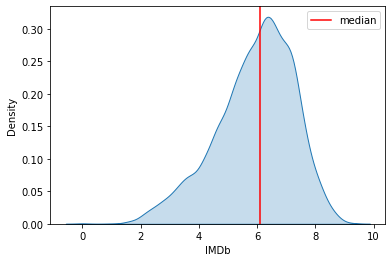

In [38]:
sns.kdeplot(movies_data['IMDb'],shade = True)
plt.axvline(x = movies_data['IMDb'].median(),color = 'red',label = 'median')
plt.legend()

In [77]:
Lang = movies_datas.drop('Language', axis=1).join(
    movies_data['Language'].str.split(',', expand=True).stack().reset_index(drop=True, level=1).rename('Language'))

Lang_count = Lang['Language'].value_counts().head(25).reset_index().set_index('index')


In [48]:
L_ratings = Lang.groupby('Language')['IMDb'].median()
L_ratings = L_ratings.reset_index().set_index('Language')

In [49]:
Top_10_lang = L_ratings.loc[['English','Hindi','Spanish','French','German','Italian'
                                                      ,'Japanese','Korean','Mandarin','Russian'],'IMDb']
Top_10_lang

Language
English     6.0
Hindi       6.5
Spanish     6.2
French      6.5
German      6.5
Italian     6.3
Japanese    6.7
Korean      6.5
Mandarin    6.4
Russian     6.4
Name: IMDb, dtype: float64

In [50]:
Top_10_lang = Top_10_lang.reset_index().set_index('Language')
English = Lang.loc[Lang['Language']=='English','IMDb'].reset_index().set_index('index')

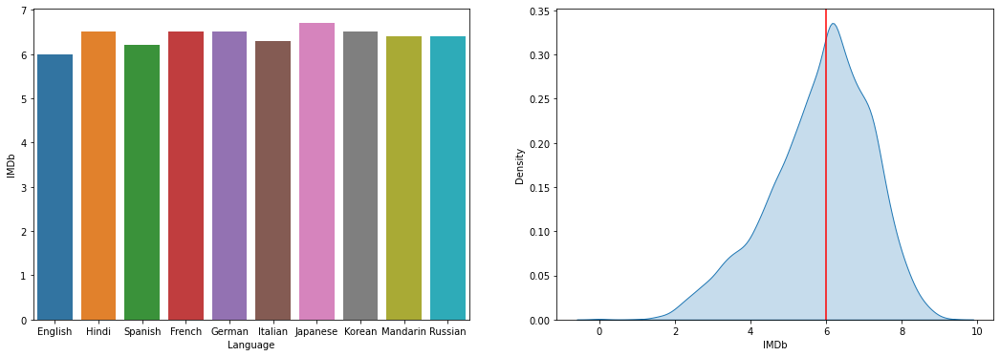

In [51]:
fig,axes = plt.subplots(1,2,figsize = (18,6))

sns.kdeplot(English['IMDb'],ax = axes[1],shade = True)
plt.axvline(English['IMDb'].median(),color = 'red')

sns.barplot(x=Top_10_lang.index,y=Top_10_lang['IMDb'],ax = axes[0])
plt.show()

In [79]:
L_Netflix = Lang.loc[Lang['Netflix'] == 1,'Language'].value_counts().reset_index().set_index('index')
L_Prime =  Lang.loc[Lang['Prime Video'] == 1,'Language'].value_counts().reset_index().set_index('index')
L_Hulu = Lang.loc[Lang['Hulu'] == 1,'Language'].value_counts().reset_index().set_index('index')
L_Disney = Lang.loc[Lang['Disney+'] == 1,'Language'].value_counts().reset_index().set_index('index')

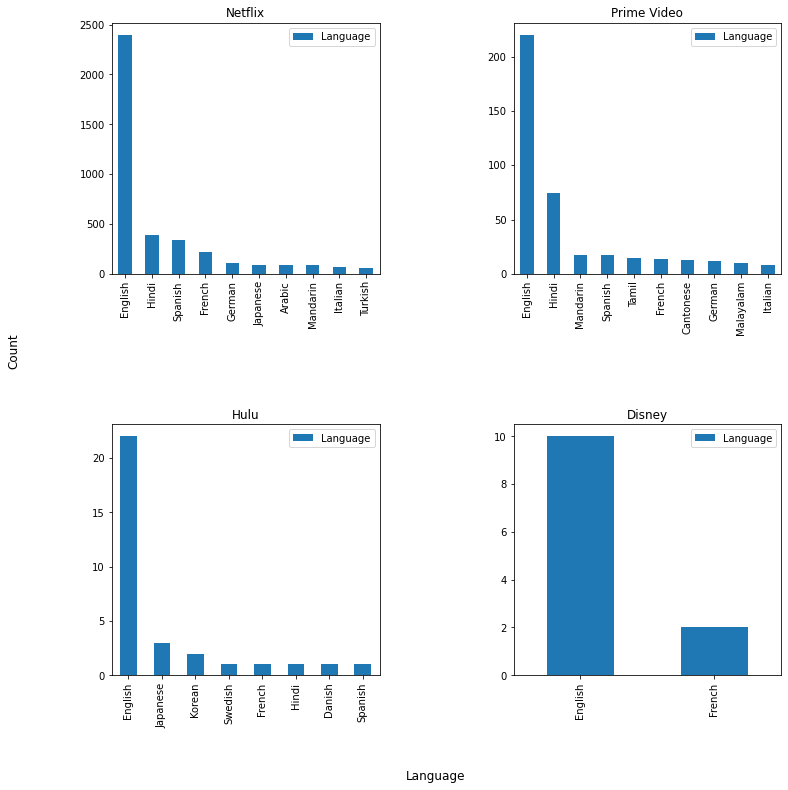

In [80]:
fig , axes = plt.subplots(2,2,figsize = (12,12))
 
plt.subplots_adjust(hspace = 0.6,wspace = 0.5)    
    
L_Netflix.head(10).plot(kind = 'bar',ax = axes[0,0])
axes[0,0].set_title('Netflix')
axes[0,0].set_xlabel('')
axes[0,0].set_ylabel('')

L_Prime.head(10).plot(kind = 'bar',ax = axes[0,1])
axes[0,1].set_title('Prime Video')
axes[0,1].set_xlabel('')
axes[0,1].set_ylabel('')


L_Hulu.head(10).plot(kind = 'bar',ax = axes[1,0])
axes[1,0].set_title('Hulu')
axes[1,0].set_xlabel('')
axes[1,0].set_ylabel('')

L_Disney.head(10).plot(kind = 'bar',ax = axes[1,1])
axes[1,1].set_title('Disney')

axes[1,1].set_xlabel('')
axes[1,1].set_ylabel('')

fig.text(0.5, 0.004, 'Language', ha='center',fontsize = 'large')
fig.text(0.004, 0.5, 'Count', va='center', rotation='vertical',fontsize = 'large')
plt.show()



In [82]:
Genre = movies_datas.drop('Genres', axis=1).join(
    movies_datas['Genres'].str.split(',', expand=True).stack().reset_index(drop=True, level=1).rename('Genre'))
Genre_count = Genre['Genre'].value_counts().reset_index().set_index('index')

In [83]:
G_Netflix = Genre.loc[Genre['Netflix'] == 1,'Genre'].value_counts().reset_index().set_index('index')
G_Prime =  Genre.loc[Genre['Prime Video'] == 1,'Genre'].value_counts().reset_index().set_index('index')
G_Hulu = Genre.loc[Genre['Hulu'] == 1,'Genre'].value_counts().reset_index().set_index('index')
G_Disney = Genre.loc[Genre['Disney+'] == 1,'Genre'].value_counts().reset_index().set_index('index')

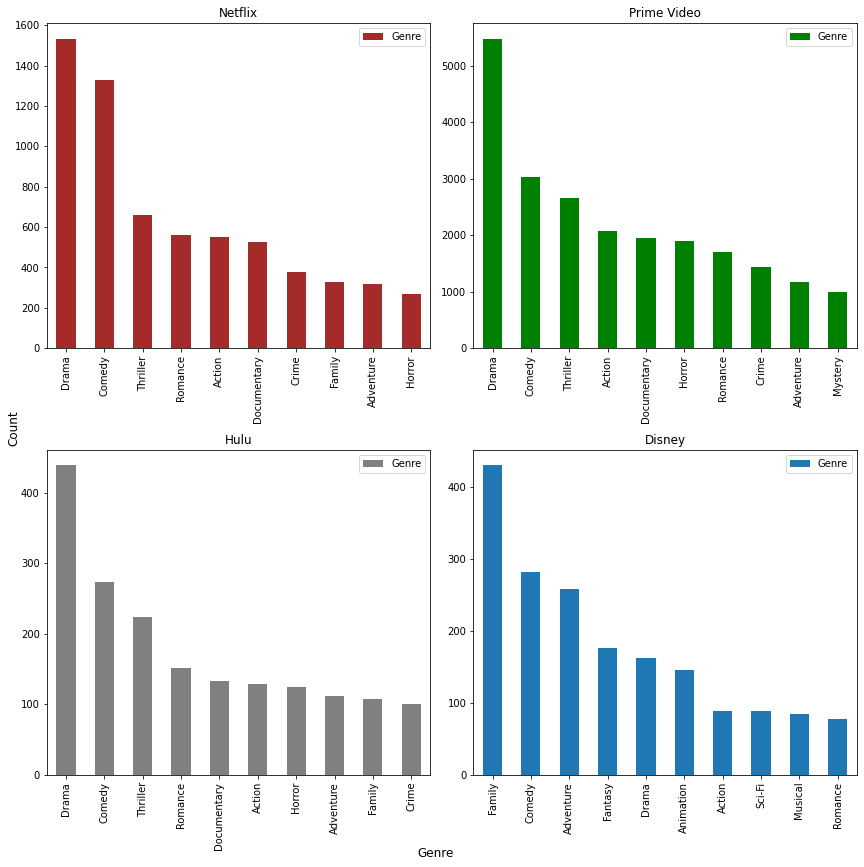

In [84]:
fig , axes = plt.subplots(2,2,figsize = (12,12))

 
G_Netflix.head(10).plot(kind = 'bar',ax = axes[0,0],color = 'brown')
axes[0,0].set_title('Netflix')
axes[0,0].set_xlabel('')
axes[0,0].set_ylabel('')

G_Prime.head(10).plot(kind = 'bar',ax = axes[0,1],color = 'green')
axes[0,1].set_title('Prime Video')
axes[0,1].set_xlabel('')

G_Hulu.head(10).plot(kind = 'bar',ax = axes[1,0],color = 'gray')
axes[1,0].set_title('Hulu')
axes[1,0].set_xlabel('')
axes[1,0].set_ylabel('')


G_Disney.head(10).plot(kind = 'bar',ax = axes[1,1])
axes[1,1].set_title('Disney')
axes[1,1].set_xlabel('')

plt.tight_layout()
fig.text(0.5, 0.004, 'Genre', ha='center',fontsize = 'large')
fig.text(0.004, 0.5, 'Count', va='center', rotation='vertical',fontsize = 'large')
plt.show()

In [32]:
netflix_content = movies_data.loc[ movies_data['Netflix'] == 1]
hulu_content = movies_data.loc[ movies_data['Hulu']==1]
prime_video_content = movies_data.loc[ movies_data['Prime Video']]
disney_content = movies_data.loc[ movies_data['Disney+']]

In [33]:
# dropping columns of other platforms and unnecessary columns

netflix_content = netflix_content.drop(['Hulu', 'Prime Video', 'Disney+', 'Type', 'Unnamed: 0','Genres'], axis = 1)
hulu_content = hulu_content.drop(['Netflix', 'Prime Video', 'Disney+', 'Type', 'Unnamed: 0','Genres'], axis = 1)
prime_video_content = prime_video_content.drop(['Hulu', 'Netflix', 'Disney+', 'Type', 'Unnamed: 0','Genres'], axis = 1)
disney_content = disney_content.drop(['Hulu', 'Prime Video', 'Netflix', 'Type', 'Unnamed: 0','Genres'], axis = 1)

In [34]:
netflix_content.head()

,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Netflix,Directors,Country,Language,Runtime
0,1,Inception,2010,13+,8.8,87%,1,Christopher Nolan,"United States,United Kingdom","English,Japanese,French",148.0
1,2,The Matrix,1999,18+,8.7,87%,1,"Lana Wachowski,Lilly Wachowski",United States,English,136.0
2,3,Avengers: Infinity War,2018,13+,8.5,84%,1,"Anthony Russo,Joe Russo",United States,English,149.0
3,4,Back to the Future,1985,7+,8.5,96%,1,Robert Zemeckis,United States,English,116.0
4,5,"The Good, the Bad and the Ugly",1966,18+,8.8,97%,1,Sergio Leone,"Italy,Spain,West Germany",Italian,161.0


In [35]:
top_10_netflix= netflix_content.sort_values(by = 'IMDb', ascending = False).head(10)
fig = px.sunburst(top_10_netflix, path= ['IMDb','Title'])
fig.show()

In [36]:
top_10_hulu= hulu_content.sort_values(by = 'IMDb', ascending = False).head(10)
fig = px.treemap(top_10_hulu, path= ['IMDb','Title'])
fig.show()

In [37]:
movies_data['OTT_Count']=movies_data['Netflix']+movies_data['Hulu']+movies_data['Prime Video']+movies_data['Disney+']

In [40]:
(movies_data['OTT_Count'].value_counts()/movies_data.shape[0])*100

1    96.255375
2     3.684902
3     0.059723
Name: OTT_Count, dtype: float64

In [41]:
movies_data[movies_data['OTT_Count']==3]

,Unnamed: 0,ID,Title,Year,Age,IMDb,Rotten Tomatoes,Netflix,Hulu,Prime Video,Disney+,Type,Directors,Genres,Country,Language,Runtime,OTT_Count
103,103,104,Amy,2015,18+,7.8,95%,1,0,1,1,0,NaN,Drama,United States,English,60.0,3
148,148,149,The Square,2013,NaN,8.1,100%,1,1,1,0,0,Ruben Östlund,"Comedy,Drama","Sweden,Germany,France,Denmark,United States","Swedish,English,Danish",151.0,3
340,340,341,The Interview,2014,18+,6.5,52%,1,1,1,0,0,"Evan Goldberg,Seth Rogen","Action,Adventure,Comedy",United States,"English,Korean",112.0,3
497,497,498,Blame!,2017,13+,6.7,82%,1,1,1,0,0,Hiroyuki Seshita,"Animation,Action,Drama,Sci-Fi,Thriller",Japan,Japanese,106.0,3
610,610,611,Evolution,2001,13+,6.1,43%,1,1,1,0,0,Ivan Reitman,"Comedy,Sci-Fi",United States,English,101.0,3
1133,1133,1134,No Game No Life: Zero,2017,13+,7.5,NaN,1,1,1,0,0,Atsuko Ishizuka,"Animation,Adventure,Comedy,Drama,Fantasy,Romance",Japan,Japanese,110.0,3
1776,1776,1777,Zapped,2014,all,5.1,NaN,1,1,0,1,0,Peter DeLuise,"Comedy,Family,Fantasy","Canada,United States",English,102.0,3
2017,2017,2018,Mother,2016,NaN,5.6,NaN,1,1,1,0,0,Darren Aronofsky,"Drama,Horror,Mystery",United States,English,121.0,3
3960,3960,3961,The Kid,2019,18+,5.9,45%,0,1,1,1,0,Vincent D'Onofrio,"Biography,Drama,Western",United States,English,100.0,3
4313,4313,4314,Inside Out,2011,13+,4.5,25%,0,1,1,1,0,"Pete Docter,Ronnie Del Carmen","Animation,Adventure,Comedy,Drama,Family,Fantasy",United States,English,95.0,3


<Figure size 864x576 with 0 Axes>

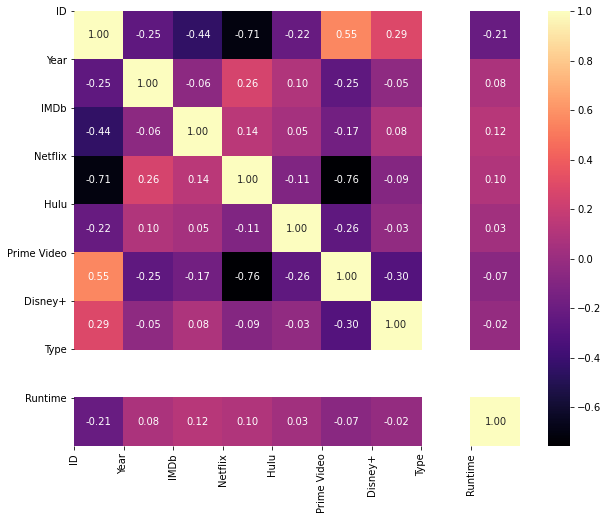

In [42]:
plt.figure(figsize=(12,8))
corr = movies_datas.corr()
#Plot figsize
fig, ax = plt.subplots(figsize=(10, 8))
#Generate Heat Map, allow annotations and place floats in map
sns.heatmap(corr, cmap='magma', annot=True, fmt=".2f")
#Apply xticks
plt.xticks(range(len(corr.columns)), corr.columns);
#Apply yticks
plt.yticks(range(len(corr.columns)), corr.columns)
#show plot
plt.show()

In [43]:
movies_datas.groupby('Genres').IMDb.agg(['count','max','min','mean'])

,count,max,min,mean
Genres,,,,
Action,146,7.3,1.6,4.798630
"Action,Adventure",48,8.4,2.1,4.972917
"Action,Adventure,Biography",3,6.9,5.2,6.200000
"Action,Adventure,Biography,Drama,History",3,8.0,7.0,7.633333
"Action,Adventure,Biography,Drama,History,Romance,War",1,2.0,2.0,2.000000
...,...,...,...,...
Western,116,8.8,1.6,5.723276
"Western,Comedy",2,4.4,3.7,4.050000
"Western,Horror",1,3.9,3.9,3.900000


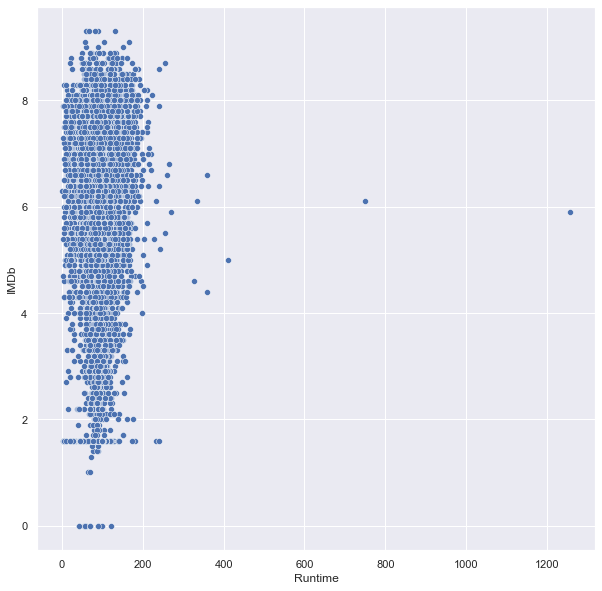

In [45]:
sns.set()
plt.figure(figsize = (10,10))
sns.scatterplot(data =movies_datas, y="IMDb", x="Runtime", palette="inferno")
plt.show()

In [9]:
genres = movies_data['Genres'].str.get_dummies(',')
data = pd.concat([movies_data,genres],axis=1,sort=False)
data.drop(['Unnamed: 0'],axis=1,inplace=True)
data.fillna(np.nan,inplace=True)

In [11]:
#KMeans - Elbow Method
distortions = []
K = range(1,100)
for k in K:
    kmean = KMeans(n_clusters=k)
    kmean.fit(scaled_data)
    distortions.append(kmean.inertia_)
fig = px.line(x=K,y=distortions,title='The Elbow Method Showing The Optimal K',
              labels={'x':'No of Clusters','y':'Distortions'})
fig.show()

In [10]:
#Select the features on the basis of ehich you want to cluster
features = data[['Action', 'Adventure', 'Animation',
                 'Biography', 'Comedy', 'Crime', 'Documentary', 'Drama', 'Family',
                 'Fantasy', 'Film-Noir', 'Game-Show', 'History', 'Horror', 'Music',
                 'Musical', 'Mystery', 'News', 'Reality-TV', 'Romance', 'Sci-Fi',
                 'Short', 'Sport', 'Talk-Show', 'Thriller', 'War', 'Western']].astype(int)

#Scaling the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(features)

#Using TSNE
tsne = TSNE(n_components=2)
transformed_genre = tsne.fit_transform(scaled_data)

In [12]:
cluster = KMeans(n_clusters=27)
group_pred = cluster.fit_predict(scaled_data)

tsne_df = pd.DataFrame(np.column_stack((transformed_genre,group_pred,data['Title'],data['Genres'])),columns=['X','Y','Group','Title','Genres'])

fig = px.scatter(tsne_df,x='X',y='Y',hover_data=['Title','Genres'],color='Group',
                 color_discrete_sequence=px.colors.cyclical.IceFire)
fig.show()

In [21]:
def sunburst(dataframe,platform,c):
    dataframe=dataframe.loc[dataframe[platform] == 1]
    dataframe=dataframe.sort_values(by='IMDb', ascending=False)
    rating = dataframe[0:10]
    fig =px.sunburst(
    rating,
    path=['Title','Genres'],
    values='IMDb',
    color='IMDb',
    color_continuous_scale=c)
    fig.show()

In [22]:
sunburst(movies_data,'Netflix','amp')

In [24]:
sunburst(movies_data,'Hulu','Blugrn')

In [25]:
sunburst(movies_data,'Prime Video','haline')